## Introduction
This information sets out to detail a wide selection of components used in the technical analysis of options. With this there is an explanation of what each component is and how it is used.


# 1. Import Libraries

In [1]:
import yfinance as yf
import pandas as pd
import numpy as np

import datetime
from datetime import date, timedelta

import matplotlib as mpl
import matplotlib.pyplot as plt
import matplotlib.style as style
from matplotlib.dates import date2num, DateFormatter, WeekdayLocator,\
    DayLocator, MONDAY
import matplotlib.patches as mpatches

import plotly.express as px
import plotly.subplots as sp
import plotly.graph_objects as go

import seaborn as sns

import mplfinance as mpf
from mplfinance.original_flavor import candlestick_ohlc

from scipy import stats
from scipy.stats import zscore
from statsmodels.tsa.stattools import adfuller
from statsmodels.tsa.stattools import coint

import warnings
warnings.filterwarnings('ignore')

import yfinance as yf

%matplotlib inline

# 2. Dow Jones Index Analysis
## 2.1 Obtaining all Dow Jones Index Tickers

Get all the tickers from the table in this Wikepedia Page
(https://en.wikipedia.org/wiki/Dow_Jones_Industrial_Average)


In [2]:
df_dow_jones = pd.read_html("https://en.wikipedia.org/wiki/Dow_Jones_Industrial_Average")[1]
tickers = df_dow_jones['Symbol'].tolist()
dow_jones_stock = yf.download(tickers, start=datetime.datetime(2010,1,1), end=datetime.datetime(2023,1,1), group_by='tickers')
dow_jones_stock

[*********************100%***********************]  30 of 30 completed


GS                                                  \
                  Open        High         Low       Close   Adj Close   
Date                                                                     
2010-01-04  170.050003  174.250000  169.509995  173.080002  137.658066   
2010-01-05  173.000000  176.259995  172.570007  176.139999  140.091858   
2010-01-06  175.380005  175.380005  173.759995  174.259995  138.596680   
2010-01-07  174.320007  178.750000  173.949997  177.669998  141.308746   
2010-01-08  176.330002  177.429993  173.949997  174.309998  138.636414   
...                ...         ...         ...         ...         ...   
2022-12-23  344.839996  347.760010  343.109985  345.510010  337.645844   
2022-12-27  346.510010  347.750000  341.790009  341.970001  334.186462   
2022-12-28  340.500000  342.850006  339.299988  340.869995  333.111450   
2022-12-29  342.440002  344.640015  341.239990  343.429993  335.613220   
2022-12-30  341.739990  343.690002  339.399994  343.380005  335.564362   

                             MMM                                      ...  \
              Volume        Open        High         Low       Close  ...   
Date                                                                  ...   
2010-01-04   9135000   83.089996   83.449997   82.669998   83.019997  ...   
2010-01-05  11659400   82.800003   83.230003   81.699997   82.500000  ...   
2010-01-06   7381100   83.879997   84.599998   83.510002   83.669998  ...   
2010-01-07   8727400   83.320000   83.760002   82.120003   83.730003  ...   
2010-01-08   7268100   83.690002   84.320000   83.300003   84.320000  ...   
...              ...         ...         ...         ...         ...  ...   
2022-12-23   1062000  120.790001  121.000000  117.800003  120.139999  ...   
2022-12-27   1035000  120.139999  120.830002  119.160004  120.220001  ...   
2022-12-28   1117200  120.349998  121.000000  118.250000  118.290001  ...   
2022-12-29   1273600  118.870003  120.860001  118.500000  120.570000  ...   
2022-12-30   1031400  119.650002  120.029999  118.510002  119.919998  ...   

                   CRM                                        CSCO             \
                   Low       Close   Adj Close   Volume       Open       High   
Date                                                                            
2010-01-04   18.547501   18.705000   18.705000  7906000  24.110001  24.840000   
2010-01-05   18.200001   18.625000   18.625000  7942400  24.600000  24.730000   
2010-01-06   18.495001   18.592501   18.592501  5122400  24.540001  24.740000   
2010-01-07   18.385000   18.510000   18.510000  4840000  24.299999  24.570000   
2010-01-08   18.315001   18.537500   18.537500  5510400  24.379999  24.700001   
...                ...         ...         ...      ...        ...        ...   
2022-12-23  127.589996  129.440002  129.440002  5821300  47.250000  47.490002   
2022-12-27  127.650002  130.660004  130.660004  8300800  47.669998  47.709999   
2022-12-28  128.169998  128.470001  128.470001  6249800  47.689999  47.770000   
2022-12-29  129.500000  132.539993  132.539993  7628800  47.259998  47.740002   
2022-12-30  130.360001  132.589996  132.589996  5630200  47.270000  47.669998   

                                                       
                  Low      Close  Adj Close    Volume  
Date                                                   
2010-01-04  24.010000  24.690001  17.011654  59853700  
2010-01-05  24.379999  24.580000  16.935858  45124500  
2010-01-06  24.340000  24.420000  16.825617  35715700  
2010-01-07  24.170000  24.530001  16.901411  31531200  
2010-01-08  24.250000  24.660000  16.990982  39115900  
...               ...        ...        ...       ...  
2022-12-23  47.009998  47.480000  46.067886   9554400  
2022-12-27  47.220001  47.529999  46.116398  12066200  
2022-12-28  46.980000  47.070000  45.670082   9847400  
2022-12-29  47.259998  47.500000  46.087299  11396500  
2022-12-30  46.950001  47.639999  46.2231

# Dow Jones Index Data 

In [3]:
dow_jones_index_stock = yf.download("^DJI", start=datetime.datetime(1984, 1, 1), 
                                     end=datetime.datetime(2023, 1, 1))
dow_jones_index_stock

[*********************100%***********************]  1 of 1 completed


,Open,High,Low,Close,Adj Close,Volume
Date,,,,,,
1992-01-02,3152.100098,3172.629883,3139.310059,3172.399902,3172.399902,23550000
1992-01-03,3172.399902,3210.639893,3165.919922,3201.500000,3201.500000,23620000
1992-01-06,3201.500000,3213.330078,3191.860107,3200.100098,3200.100098,27280000
1992-01-07,3200.100098,3210.199951,3184.479980,3204.800049,3204.800049,25510000
1992-01-08,3204.800049,3229.199951,3185.820068,3203.899902,3203.899902,29040000
...,...,...,...,...,...,...
2022-12-23,32961.058594,33226.140625,32814.019531,33203.929688,33203.929688,221050000
2022-12-27,33224.230469,33387.718750,33069.578125,33241.558594,33241.558594,246010000
2022-12-28,33264.761719,33379.550781,32869.148438,32875.710938,32875.710938,252260000


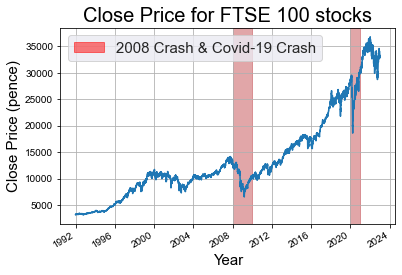

In [4]:
def dow_jones_index_stock_plot():
    dow_jones_index_stock['Close'].plot(grid=True)
    sns.set(rc={'figure.figsize': (20, 10)})
    plt.axvspan('2008', '2010', color='r', alpha=0.5)
    plt.axvspan('2020', '2021', color='r', alpha=0.5)
    labs = mpatches.Patch(color='red', alpha=0.5, label="2008 Crash & Covid-19 Crash")
    plt.legend(handles=[labs], prop={"size": 15}, loc='upper left')  # Adjust the legend location
    plt.title('Close Price for FTSE 100 stocks', color='black', fontsize=20)
    plt.xlabel('Year', color='black', fontsize=15)
    plt.ylabel('Close Price (pence)', color='black', fontsize=15)
    plt.show()

dow_jones_index_stock_plot()



The plot distinctly illustrates significant market events in 1987, the Global Financial Crisis of 2008, and the Coronavirus Crash in 2020. It also seems to validate the general upward trend in stock prices from 2010 to 2019, as observed in the analyzed stock selection.

# 5. Extracting an individual stock
Here we are going to conisder AAPL


In [5]:
aapl = dow_jones_stock['AAPL']
aapl.head()

,Open,High,Low,Close,Adj Close,Volume
Date,,,,,,
2010-01-04,7.622500,7.660714,7.585000,7.643214,6.487534,493729600
2010-01-05,7.664286,7.699643,7.616071,7.656429,6.498750,601904800
2010-01-06,7.656429,7.686786,7.526786,7.534643,6.395380,552160000
2010-01-07,7.562500,7.571429,7.466071,7.520714,6.383554,477131200
2010-01-08,7.510714,7.571429,7.466429,7.570714,6.425996,447610800


## 5.1 Visualising Stock Data
Japanese candlestick charts serve as instruments within the price action trading style. They aid in forecasting market movements by identifying patterns associated with continuations, breakouts, and reversals.

In contrast to a line chart, these charts offer a comprehensive view of price data in a single visualization, including the day's high, low, open, and closing prices or the chosen time frame. Practitioners of price action analysis scrutinize patterns formed by green bullish candles, signifying an upward trend, and red or black bearish candles, indicating a downward trend.

In [6]:
def pandas_candlestick_ohlc(dat, stick = "day", otherseries = None):
    """
    Japanese candlestick chart showing OHLC prices for a specified time period
    
    :param dat: pandas dataframe object with datetime64 index, and float columns "Open", "High", "Low", and "Close"
    :param stick: A string or number indicating the period of time covered by a single candlestick. Valid string inputs include "day", "week", "month", and "year", ("day" default), and any numeric input indicates the number of trading days included in a period
    :param otherseries: An iterable that will be coerced into a list, containing the columns of dat that hold other series to be plotted as lines
 
    :returns: a Japanese candlestick plot for stock data stored in dat, also plotting other series if passed.
    """
    mondays = WeekdayLocator(MONDAY)        # major ticks on the mondays
    alldays = DayLocator()              # minor ticks on the days
    dayFormatter = DateFormatter('%d')      # e.g., 12
 
    # Create a new DataFrame which includes OHLC data for each period specified by stick input
    transdat = dat.loc[:,["Open", "High", "Low", "Close"]]
    if (type(stick) == str):
        if stick == "day":
            plotdat = transdat
            stick = 1 # Used for plotting
        elif stick in ["week", "month", "year"]:
            if stick == "week":
                transdat["week"] = pd.to_datetime(transdat.index).map(lambda x: x.isocalendar()[1]) # Identify weeks
            elif stick == "month":
                transdat["month"] = pd.to_datetime(transdat.index).map(lambda x: x.month) # Identify months
            transdat["year"] = pd.to_datetime(transdat.index).map(lambda x: x.isocalendar()[0]) # Identify years
            grouped = transdat.groupby(list(set(["year",stick]))) # Group by year and other appropriate variable
            plotdat = pd.DataFrame({"Open": [], "High": [], "Low": [], "Close": []}) # Create empty data frame containing what will be plotted
            for name, group in grouped:
                plotdat = plotdat.append(pd.DataFrame({"Open": group.iloc[0,0],
                                            "High": max(group.High),
                                            "Low": min(group.Low),
                                            "Close": group.iloc[-1,3]},
                                           index = [group.index[0]]))
            if stick == "week": stick = 5
            elif stick == "month": stick = 30
            elif stick == "year": stick = 365
 
    elif (type(stick) == int and stick >= 1):
        transdat["stick"] = [np.floor(i / stick) for i in range(len(transdat.index))]
        grouped = transdat.groupby("stick")
        plotdat = pd.DataFrame({"Open": [], "High": [], "Low": [], "Close": []}) # Create empty data frame containing what will be plotted
        for name, group in grouped:
            plotdat = plotdat.append(pd.DataFrame({"Open": group.iloc[0,0],
                                        "High": max(group.High),
                                        "Low": min(group.Low),
                                        "Close": group.iloc[-1,3]},
                                       index = [group.index[0]]))
 
    else:
        raise ValueError('Valid inputs to argument "stick" include the strings "day", "week", "month", "year", or a positive integer')
 
 
    # Set plot parameters, including the axis object ax used for plotting
    fig, ax = plt.subplots()
    fig.subplots_adjust(bottom=0.2)
    if plotdat.index[-1] - plotdat.index[0] < pd.Timedelta('730 days'):
        weekFormatter = DateFormatter('%b %d')  # e.g., Jan 12
        ax.xaxis.set_major_locator(mondays)
        ax.xaxis.set_minor_locator(alldays)
    else:
        weekFormatter = DateFormatter('%b %d, %Y')
    ax.xaxis.set_major_formatter(weekFormatter)
 
    ax.grid(True)
 
    # Create the candelstick chart
    candlestick_ohlc(ax, list(zip(list(date2num(plotdat.index.tolist())), plotdat["Open"].tolist(), plotdat["High"].tolist(),
                      plotdat["Low"].tolist(), plotdat["Close"].tolist())),
                      colorup = "green", colordown = "red", width = stick * .4)
 
    # Plot other series (such as moving averages) as lines
    if otherseries != None:
        if type(otherseries) != list:
            otherseries = [otherseries]
        dat.loc[:,otherseries].plot(ax = ax, lw = 1.3, grid = True)
 
    ax.xaxis_date()
    ax.autoscale_view()
    plt.setp(plt.gca().get_xticklabels(), rotation=45, horizontalalignment='right')
    sns.set(rc={'figure.figsize':(20, 10)})
    plt.style.use('seaborn-whitegrid')
    plt.title(f"Candlestick chart of {txt}", color = 'black', fontsize = 20)
    plt.xlabel('Date', color = 'black', fontsize = 15)
    plt.ylabel('Stock Price (p)', color = 'black', fontsize = 15);
 
    plt.show()

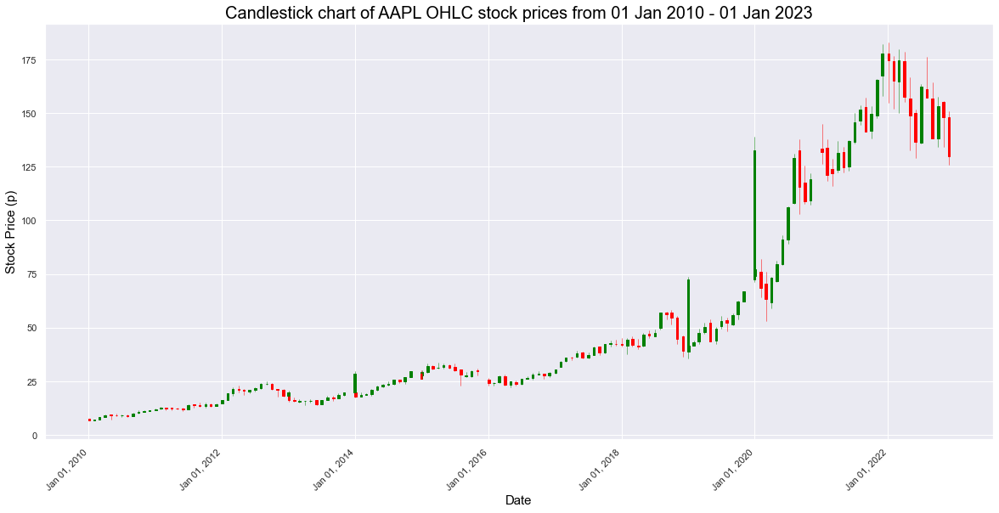

In [7]:
txt = "AAPL OHLC stock prices from 01 Jan 2010 - 01 Jan 2023"

pandas_candlestick_ohlc(aapl, stick="month")

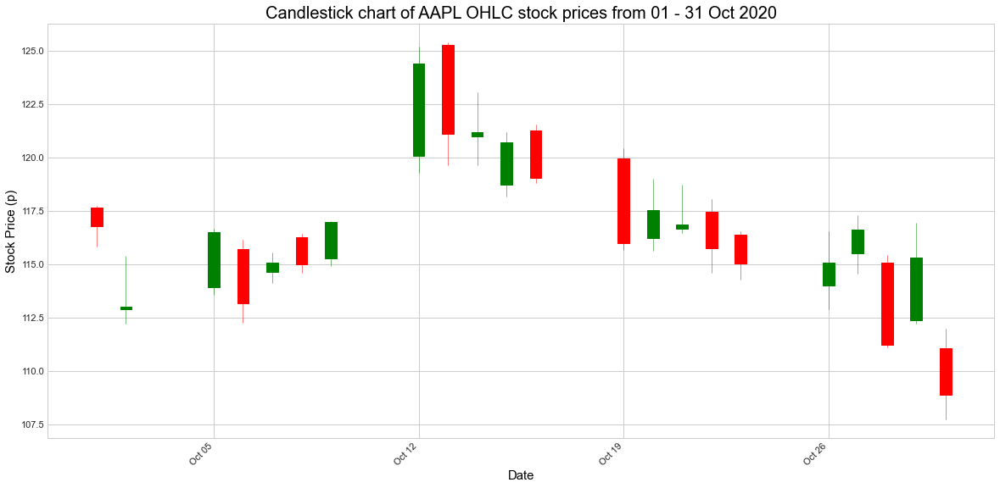

In [8]:
# Plot candlestick chart for one month period for Oct 2020

txt = "AAPL OHLC stock prices from 01 - 31 Oct 2020"

pandas_candlestick_ohlc(aapl['2020-10-01':'2020-10-31'], stick="day")

# 6. Technical Indicators and Strategies
A technical indicator refers to a sequence of data points obtained by applying a mathematical formula to the price data of a financial asset. In essence, these indicators are mathematical tools that convert the movement and price levels of an asset into measurable time-based patterns.

These indicators can be classified into two main categories: leading and lagging indicators. Within these categories, there are four types of indicators: trend, momentum, volatility, and volume. These indicators fulfill three primary roles: signaling potential market shifts, confirming existing trends, and forecasting future price movements.

## 6.1 Trend-following Strategies
Trend-following involves capitalizing on the current market trend by purchasing an asset as its price trend ascends and selling it when the trend reverses and starts to decline. This approach anticipates that price movements will persist in the same direction as the prevailing trend.

## 6.1.1 Moving Averages
Moving averages act as a smoothing mechanism for a dataset, effectively reducing noise and aiding in the recognition of trends. They align with a fundamental tenet of technical analysis, which asserts that prices exhibit trending behavior. There are various types of moving averages, such as simple, exponential, smoothed, and linear-weighted, as well as the Moving Average Convergence Divergence (MACD). These moving averages function as lagging indicators, trailing behind the price action. Consequently, they are often termed trend-following indicators.

## 6.1.2 Simple Moving Average (SMA)
The simplest form of a moving average, known as a Simple Moving Average (SMA), operates by computing the average of a specific set of values over a defined time period. This approach is relatively straightforward and assumes that the next data point is merely the average of all past data points, with each value in the time period carrying equal weight.

When considering this as an averaging problem, we aim to forecast future stock market prices (e.g., xt+1) by taking the average of previously observed stock market prices within a fixed-size window (e.g., xt-n, ..., xt). This technique serves to smoothen the price data by continuously updating an average price. As a result, it reduces the impact of random, short-term fluctuations on the stock price over the specified time frame.

In [9]:
def sma():
    # Create a Plotly figure
    fig = go.Figure()

    # Calculate the 20-day moving average
    sma_20 = dow_jones_stock[ticker]['Adj Close'].loc['2019-01-01':'2019-12-31'].rolling(window=20).mean()

    # Add the 20-day moving average trace
    fig.add_trace(go.Scatter(x=sma_20.index, y=sma_20, mode='lines', name='20 Day Avg'))

    # Add the stock's adjusted close prices
    fig.add_trace(go.Scatter(x=dow_jones_stock[ticker]['Adj Close'].loc['2019-01-01':'2019-12-31'].index, 
                             y=dow_jones_stock[ticker]['Adj Close'].loc['2019-01-01':'2019-12-31'], 
                             mode='lines', name=f"{label_txt}"))

    # Customize the layout
    fig.update_layout(
        title=f"{title_txt}",
        xaxis_title='Date',
        yaxis_title='Stock Price (p)',
        width=1000,
        height=600,
        showlegend=True
    )

    # Show the plot
    fig.show()

In [10]:
ticker = 'AAPL'
title_txt = "20-day Simple Moving Average for AAPL stock"
label_txt = "AAPL Adj Close"

sma()

The SMA follows the time series removing noise from the signal but keeping the overall trend. If the stock price is above its moving average it is assumed that it will likely continue rising in an uptrend.

## 6.1.3 Moving Average Crossover Strategy
The most widely adopted moving average crossover strategy, often considered the "Hello World!" of quantitative trading due to its simplicity, is based on the use of the simple moving average (SMA). When these moving averages intersect, it typically signifies a shift in the prevailing trend. The question arises whether, over an extended period, the delay introduced by the moving average can still yield profitable trading outcomes.

The choice of the moving average's time period depends on the investor or trader's specific characteristics, including risk tolerance, trading horizon (short-term vs. long-term), and objectives. Adjusting the "time" average can involve intervals like 10 days, 20 days, 50 days, 200 days, 1 year, 5 years, and so on. The longer the SMA period, the more extended the time frame it captures in the trend analysis. Typically, a 20-day SMA suits short-term (swing) trading, a 50-day SMA works for medium-term (position) trading, and a 200-day SMA suits long-term (portfolio) investment.

It's crucial to recognize that there's no universally correct answer to this decision. It varies based on whether a trader intends to buy during a downward trend and sell during an upward one, potentially capitalizing on short-term gains, or to hold the position for a more extended period as part of a long-term investment strategy. The choice ultimately aligns with an individual's unique trading preferences and objectives.

In [11]:
def sma2():
    # Create a Plotly figure
    fig = go.Figure()

    # Calculate the rolling moving averages
    moving_avg_20 = dow_jones_stock[ticker]['Adj Close'].loc['2016-01-01':'2019-12-31'].rolling(window=20).mean()
    moving_avg_50 = dow_jones_stock[ticker]['Adj Close'].loc['2016-01-01':'2019-12-31'].rolling(window=50).mean()
    moving_avg_200 = dow_jones_stock[ticker]['Adj Close'].loc['2016-01-01':'2019-12-31'].rolling(window=200).mean()
    stock_data = dow_jones_stock[ticker]['Adj Close'].loc['2016-01-01':'2019-12-31']

    # Add traces for each moving average and the stock price
    fig.add_trace(go.Scatter(x=stock_data.index, y=moving_avg_20, mode='lines', name='20 Day Avg'))
    fig.add_trace(go.Scatter(x=stock_data.index, y=moving_avg_50, mode='lines', name='50 Day Avg'))
    fig.add_trace(go.Scatter(x=stock_data.index, y=moving_avg_200, mode='lines', name='200 Day Avg'))
    fig.add_trace(go.Scatter(x=stock_data.index, y=stock_data, mode='lines', name=f"{label_txt}"))

    # Customize the layout
    fig.update_layout(
        title=f"{title_txt}",
        xaxis_title='Date',
        yaxis_title='Stock Price (p)',
        width=1000,
        height=600,
        showlegend=True
    )

    # Show the plot
    fig.show()

In [12]:
title_txt = "20, 50 and 200 day moving averages for AAPL stock"
label_txt = "AAPL Adj Close"

sma2()

In [13]:
# 20, 50 and 200 day MA repeated for IBM Adjusted Close price data for the same time period 

ticker = 'IBM'

title_txt = "20, 50 and 200 day moving averages for IBM stock"
label_txt = "IBM Adj Close"

sma2()

## Trading Strategy
The moving average crossover trading strategy will be to take two moving averages - 20-day (fast) and 200-day (slow) - and to go long (buy) when the fast MA goes above the slow MA and to go short (sell) when the fast MA goes below the slow MA.

In [14]:
aapl_sma = aapl.copy()
aapl_sma

,Open,High,Low,Close,Adj Close,Volume
Date,,,,,,
2010-01-04,7.622500,7.660714,7.585000,7.643214,6.487534,493729600
2010-01-05,7.664286,7.699643,7.616071,7.656429,6.498750,601904800
2010-01-06,7.656429,7.686786,7.526786,7.534643,6.395380,552160000
2010-01-07,7.562500,7.571429,7.466071,7.520714,6.383554,477131200
2010-01-08,7.510714,7.571429,7.466429,7.570714,6.425996,447610800
...,...,...,...,...,...,...
2022-12-23,130.919998,132.419998,129.639999,131.860001,131.299820,63814900
2022-12-27,131.380005,131.410004,128.720001,130.029999,129.477600,69007800
2022-12-28,129.669998,131.029999,125.870003,126.040001,125.504539,85438400


In [15]:
# Calculate and add columns for moving averages of Adjusted Close price data

aapl_sma["20d"] = np.round(aapl_sma["Adj Close"].rolling(window = 20, center = False).mean(), 2)
aapl_sma["50d"] = np.round(aapl_sma["Adj Close"].rolling(window = 50, center = False).mean(), 2)
aapl_sma["200d"] = np.round(aapl_sma["Adj Close"].rolling(window = 200, center = False).mean(), 2)
aapl_sma.tail()

,Open,High,Low,Close,Adj Close,Volume,20d,50d,200d
Date,,,,,,,,,
2022-12-23,130.919998,132.419998,129.639999,131.860001,131.299820,63814900,140.06,143.45,151.12
2022-12-27,131.380005,131.410004,128.720001,130.029999,129.477600,69007800,139.36,143.29,151.00
2022-12-28,129.669998,131.029999,125.870003,126.040001,125.504539,85438400,138.60,142.96,150.88
2022-12-29,127.989998,130.479996,127.730003,129.610001,129.059387,75703700,137.69,142.69,150.76
2022-12-30,128.410004,129.949997,127.430000,129.929993,129.378006,77034200,136.77,142.41,150.62


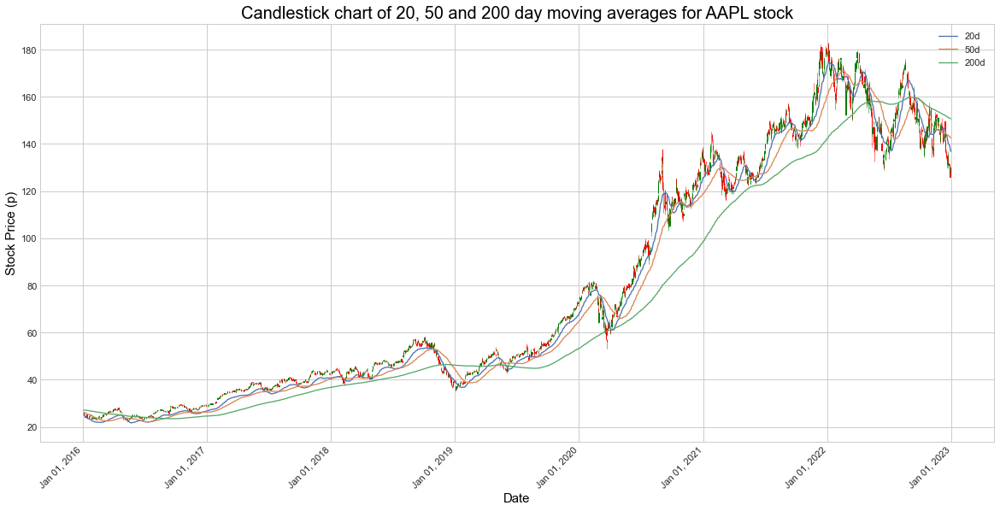

In [16]:
txt = "20, 50 and 200 day moving averages for AAPL stock"

# Slice rows to plot data from 2016-2023 
pandas_candlestick_ohlc(aapl_sma.loc['2016-01-01':'2023-12-31',:], otherseries = ["20d", "50d", "200d"])

## Backtesting 

In [17]:
# Identify when the 20-day average is below the 200-day average, and vice versa.

aapl_sma['20d-200d'] = aapl_sma['20d'] - aapl_sma['200d']
aapl_sma.tail()

,Open,High,Low,Close,Adj Close,Volume,20d,50d,200d,20d-200d
Date,,,,,,,,,,
2022-12-23,130.919998,132.419998,129.639999,131.860001,131.299820,63814900,140.06,143.45,151.12,-11.06
2022-12-27,131.380005,131.410004,128.720001,130.029999,129.477600,69007800,139.36,143.29,151.00,-11.64
2022-12-28,129.669998,131.029999,125.870003,126.040001,125.504539,85438400,138.60,142.96,150.88,-12.28
2022-12-29,127.989998,130.479996,127.730003,129.610001,129.059387,75703700,137.69,142.69,150.76,-13.07
2022-12-30,128.410004,129.949997,127.430000,129.929993,129.378006,77034200,136.77,142.41,150.62,-13.85


In [18]:
fig = go.Figure()

# Calculate the regime values using np.where() and add them to the figure
aapl_sma["Regime"] = np.where(aapl_sma['20d-200d'] > 0, 1, 0)
aapl_sma["Regime"] = np.where(aapl_sma['20d-200d'] < 0, -1, aapl_sma["Regime"])

# Plot the regime values
fig.add_trace(go.Scatter(x=aapl_sma.loc['2016-01-01':'2023-12-31'].index, y=aapl_sma.loc['2016-01-01':'2023-12-31']["Regime"], mode='lines', name='Regime'))
fig.add_shape(type="line", x0=aapl_sma.loc['2016-01-01':'2023-12-31'].index.min(), x1=aapl_sma.loc['2016-01-01':'2023-12-31'].index.max(), y0=0, y1=0, line=dict(color="black", width=2))

# Customize the layout
fig.update_layout(
    title="Regime for AAPL 20- and 200-day Moving Average Crossover Strategy for 2016-2023",
    xaxis_title='Date',
    yaxis_title='Regime',
    width=1000,
    height=500,
)

# Show the plot
fig.show()

In [19]:
fig = go.Figure()

# Plot the regime values for AAPL
fig.add_trace(go.Scatter(x=aapl_sma.index, y=aapl_sma["Regime"], mode='lines', name='Regime'))
fig.add_shape(type="line", x0=aapl_sma.index.min(), x1=aapl_sma.index.max(), y0=0, y1=0, line=dict(color="black", width=2))

# Customize the layout
fig.update_layout(
    title="Regime for AAPL 20- and 200-day Moving Average Crossover Strategy for 2010-2023",
    xaxis_title='Date',
    yaxis_title='Regime',
    width=1000,
    height=500,
    yaxis=dict(range=[-2, 2]),  # Set the y-axis range
)

# Show the plot
fig.show()

In [20]:
# Number of bullish and bearish days

aapl_sma["Regime"].value_counts()

 1    2390
-1     683
 0     199
Name: Regime, dtype: int64

For 2390 days the market was bullish, for 683 days it was bearish, and neutral for 199 days for the time period 2010-2023.

In [21]:
# Create a Plotly figure
fig = go.Figure()

# Define the signals
aapl_sma["Signal"] = np.sign(aapl_sma["Regime"] - aapl_sma["Regime"].shift(1))
regime_orig = aapl_sma.iloc[-1, 10]
aapl_sma.iloc[-1, 10] = 0

# Plot the signals
fig.add_trace(go.Scatter(x=aapl_sma.index, y=aapl_sma["Signal"], mode='lines', name='Signal'))

# Restore original regime data
aapl_sma.iloc[-1, 10] = regime_orig

# Customize the layout
fig.update_layout(
    title="Trading Signals for AAPL 20- and 200-day Moving Average Crossover Strategy",
    xaxis_title='Date',
    yaxis_title='Signal',
    width=1000,
    height=500,
)

# Show the plot
fig.show()

In [22]:
# Create a Plotly figure
fig = go.Figure()

# Plot the trading signals
fig.add_trace(go.Scatter(x=aapl_sma.index, y=aapl_sma["Signal"], mode='lines', name='Trading Signal'))

# Customize the layout
fig.update_layout(
    title="Trading Signals for AAPL 20- and 200-day Moving Average Crossover Strategy",
    xaxis_title='Date',
    yaxis_title='Trading Signal',
    width=1000,
    height=500,
    yaxis=dict(range=[-2, 2]),
)

# Show the plot
fig.show()

In [23]:
# Unique counts of trading signals

aapl_sma["Signal"].value_counts()

 0.0    3257
 1.0       7
-1.0       7
Name: Signal, dtype: int64

We would buy APPLE stock 7 times and sell 7 times. If we only go long 7 trades will be engaged in over the 10-year period, while if we pivot from a long to a short position every time a long position is terminated, we would engage in 7 trades total. It is worth bearing in mind that trading more frequently isn’t necessarily good as trades are never free.

In [24]:
# Identify what the price of the stock is at every buy.

aapl_sma.loc[aapl_sma["Signal"] == 1, "Close"]

Date
2010-10-18     11.357143
2013-08-19     18.133572
2016-08-10     27.000000
2019-04-08     50.025002
2019-06-24     49.645000
2020-04-14     71.762497
2022-08-12    172.100006
Name: Close, dtype: float64

In [25]:
# Identify what the price of the stock is at every sell.

aapl_sma.loc[aapl_sma["Signal"] == -1, "Close"]

Date
2012-11-14     19.174286
2015-08-14     28.990000
2018-11-29     44.887501
2019-05-31     43.767502
2020-04-07     64.857498
2022-05-12    142.559998
2022-09-16    150.699997
Name: Close, dtype: float64

In [26]:
# Create a dataframe with trades, including the price at the trade and the regime under which the trade is made.

aapl_signals = pd.concat([
        pd.DataFrame({"Price": aapl_sma.loc[aapl_sma["Signal"] == 1, "Adj Close"],
                     "Regime": aapl_sma.loc[aapl_sma["Signal"] == 1, "Regime"],
                     "Signal": "Buy"}),
        pd.DataFrame({"Price": aapl_sma.loc[aapl_sma["Signal"] == -1, "Adj Close"],
                     "Regime": aapl_sma.loc[aapl_sma["Signal"] == -1, "Regime"],
                     "Signal": "Sell"}),
    ])
aapl_signals.sort_index(inplace = True)
aapl_signals

,Price,Regime,Signal
Date,,,
2010-10-18,9.639904,1,Buy
2012-11-14,16.419598,-1,Sell
2013-08-19,15.826098,1,Buy
2015-08-14,26.314425,-1,Sell
2016-08-10,25.032095,1,Buy
2018-11-29,43.140278,-1,Sell
2019-04-08,48.283997,1,Buy
2019-05-31,42.406960,-1,Sell
2019-06-24,48.101742,1,Buy


In [27]:
# Let's see the profitability of long trades
aapl_long_profits = pd.DataFrame({
    "Price": aapl_signals.loc[(aapl_signals["Signal"] == "Buy") &
                              aapl_signals["Regime"] == 1, "Price"],
    "Profit": pd.Series(aapl_signals["Price"] - aapl_signals["Price"].shift(1)).loc[
        aapl_signals.loc[(aapl_signals["Signal"].shift(1) == "Buy") & (aapl_signals["Regime"].shift(1) == 1)].index
    ].tolist(),
    "End Date": aapl_signals["Price"].loc[
        aapl_signals.loc[(aapl_signals["Signal"].shift(1) == "Buy") & (aapl_signals["Regime"].shift(1) == 1)].index
    ].index
})
aapl_long_profits

,Price,Profit,End Date
Date,,,
2010-10-18,9.639904,6.779694,2012-11-14
2013-08-19,15.826098,10.488326,2015-08-14
2016-08-10,25.032095,18.108183,2018-11-29
2019-04-08,48.283997,-5.877037,2019-05-31
2019-06-24,48.101742,15.317905,2020-04-07
2020-04-14,70.171585,71.351105,2022-05-12
2022-08-12,171.085052,-21.273773,2022-09-16


## 6.1.4 Exponential Moving Average 
A Simple Moving Average (SMA) gives equal importance to all values within its defined time period, excluding those outside of it. In contrast, the Exponential Moving Average (EMA) assigns varying decreasing weights to each observation. Older values have a diminishing impact on the average, while recent values carry more weight. This approach makes the EMA more sensitive and responsive to shifts in the underlying data.

In [28]:
def ewma():
    # Create a Plotly figure
    fig = go.Figure()

    # Add a trace for the 20-day Exponential Moving Average
    fig.add_trace(go.Scatter(
        x=dow_jones_stock[ticker]['Adj Close'].loc['2019-01-01':'2019-12-31'].index,
        y=dow_jones_stock[ticker]['Adj Close'].loc['2019-01-01':'2019-12-31'].ewm(20).mean(),
        mode='lines',
        name='20 Day Avg'
    ))

    # Add a trace for the stock's adjusted close price
    fig.add_trace(go.Scatter(
        x=dow_jones_stock[ticker]['Adj Close'].loc['2019-01-01':'2019-12-31'].index,
        y=dow_jones_stock[ticker]['Adj Close'].loc['2019-01-01':'2019-12-31'],
        mode='lines',
        name=label_txt
    ))

    # Customize the layout
    fig.update_layout(
        title=title_txt,
        xaxis_title='Date',
        yaxis_title='Stock Price (p)',
        width=1000,
        height=600,
        showlegend=True
    )

    # Show the plot
    fig.show()

In [29]:
ticker = 'AAPL'
title_txt = "20-day Exponential Moving Average for AAPL stock"
label_txt = "AAPL Adj Close"

ewma()

In [30]:
def ewma2():
    # Create a Plotly figure
    fig = go.Figure()

    # Add a trace for the 20-day Exponential Moving Average
    fig.add_trace(go.Scatter(
        x=dow_jones_stock[ticker]['Adj Close'].loc['2016-01-01':'2019-12-31'].index,
        y=dow_jones_stock[ticker]['Adj Close'].loc['2016-01-01':'2019-12-31'].ewm(20).mean(),
        mode='lines',
        name='20 Day Avg'
    ))

    # Add a trace for the 50-day Exponential Moving Average
    fig.add_trace(go.Scatter(
        x=dow_jones_stock[ticker]['Adj Close'].loc['2016-01-01':'2019-12-31'].index,
        y=dow_jones_stock[ticker]['Adj Close'].loc['2016-01-01':'2019-12-31'].ewm(50).mean(),
        mode='lines',
        name='50 Day Avg'
    ))

    # Add a trace for the 200-day Exponential Moving Average
    fig.add_trace(go.Scatter(
        x=dow_jones_stock[ticker]['Adj Close'].loc['2016-01-01':'2019-12-31'].index,
        y=dow_jones_stock[ticker]['Adj Close'].loc['2016-01-01':'2019-12-31'].ewm(200).mean(),
        mode='lines',
        name='200 Day Avg'
    ))

    # Add a trace for the stock's adjusted close price
    fig.add_trace(go.Scatter(
        x=dow_jones_stock[ticker]['Adj Close'].loc['2016-01-01':'2019-12-31'].index,
        y=dow_jones_stock[ticker]['Adj Close'].loc['2016-01-01':'2019-12-31'],
        mode='lines',
        name=label_txt
    ))

    # Customize the layout
    fig.update_layout(
        title=title_txt,
        xaxis_title='Date',
        yaxis_title='Stock Price (p)',
        width=1000,
        height=600,
        showlegend=True
    )

    # Show the plot
    fig.show()


In [31]:
title_txt = "20, 50 and 200-day Exponential Moving Averages for AAPL stock"
label_txt = "AAPL Adj Close"

ewma2()

## 6.1.6 Triple Moving Average Crossover Strategy
This trading strategy employs three distinct moving averages: a short/fast one, a middle/medium one, and a long/slow one, resulting in two key buy and sell signals.

The initial buy signal triggers when the middle/medium moving average surpasses the long/slow moving average, and simultaneously, the short/fast moving average exceeds the middle/medium moving average. If this buy signal is implemented, the strategy dictates selling when the short/fast moving average falls below the middle/medium moving average.

Conversely, the second buy signal is activated when the middle/medium moving average falls beneath the long/slow moving average, and concurrently, the short/fast moving average drops below the middle/medium moving average. In the event of employing this buy signal, the strategy recommends selling when the short/fast moving average rises above the middle/medium moving average.

In [32]:
aapl[['Adj Close']]['2020-01-01':'2020-10-31']

,Adj Close
Date,
2020-01-02,73.249023
2020-01-03,72.536896
2020-01-06,73.114891
2020-01-07,72.771011
2020-01-08,73.941628
...,...
2020-10-26,113.007362
2020-10-27,114.529823
2020-10-28,109.225685


In [33]:
def adj_6mo():
    fig = px.line(dow_jones_stock[ticker]['Adj Close'].loc['2020-01-01':'2020-10-31'], title=title_txt, labels={'index': 'Date', 'value': 'Stock Price (p)'})
    fig.update_layout(showlegend=True)
    fig.show()

In [34]:
title_txt = "AAPL Adjusted Close Price from 1 Jan - 31 Oct 2020"
label_txt = "AAPL Adj Close "

adj_6mo()

In [35]:
aapl_adj_6mo = aapl[['Adj Close']]['2020-01-01':'2020-10-31']
ShortEMA = aapl_adj_6mo['Adj Close'].ewm(span=5, adjust=False).mean()
MiddleEMA = aapl_adj_6mo['Adj Close'].ewm(span=21, adjust=False).mean()
LongEMA = aapl_adj_6mo['Adj Close'].ewm(span=63, adjust=False).mean()

In [36]:
def ewma3():
    fig = go.Figure()

    fig.add_trace(go.Scatter(x=dow_jones_stock[ticker]['Adj Close'].loc['2020-01-01':'2020-10-31'].index, 
                             y=dow_jones_stock[ticker]['Adj Close'].loc['2020-01-01':'2020-10-31'], 
                             mode='lines',
                             name=label_txt,
                             line=dict(color='blue')))

    fig.add_trace(go.Scatter(x=ShortEMA.index, 
                             y=ShortEMA, 
                             mode='lines',
                             name='Short/Fast EMA',
                             line=dict(color='red')))

    fig.add_trace(go.Scatter(x=MiddleEMA.index, 
                             y=MiddleEMA, 
                             mode='lines',
                             name='Middle/Medium EMA',
                             line=dict(color='orange')))

    fig.add_trace(go.Scatter(x=LongEMA.index, 
                             y=LongEMA, 
                             mode='lines',
                             name='Long/Slow EMA',
                             line=dict(color='green')))

    fig.update_layout(title=title_txt,
                      xaxis_title='Date',
                      yaxis_title='Stock Price (p)',
                      legend=dict(orientation="h", yanchor="bottom", y=1, xanchor="right", x=1),
                      showlegend=True)

    fig.show()

In [37]:
title_txt = "Triple Exponential Moving Average Crossover for AAPL stock"
label_txt = "AAPL Adj Close"

ewma3()

In [38]:
aapl_adj_6mo['Short'] = ShortEMA
aapl_adj_6mo['Middle'] = MiddleEMA
aapl_adj_6mo['Long'] = LongEMA
aapl_adj_6mo

,Adj Close,Short,Middle,Long
Date,,,,
2020-01-02,73.249023,73.249023,73.249023,73.249023
2020-01-03,72.536896,73.011648,73.184285,73.226769
2020-01-06,73.114891,73.046062,73.177976,73.223273
2020-01-07,72.771011,72.954378,73.140979,73.209140
2020-01-08,73.941628,73.283461,73.213765,73.232030
...,...,...,...,...
2020-10-26,113.007362,113.893139,114.472905,110.249941
2020-10-27,114.529823,114.105367,114.478079,110.383688
2020-10-28,109.225685,112.478807,114.000589,110.347500


In [39]:
def buy_sell_ewma3(data):
  
  buy_list = []
  sell_list = []
  flag_long = False
  flag_short = False

  for i in range(0, len(data)):
    if data['Middle'][i] < data['Long'][i] and data['Short'][i] < data['Middle'][i] and flag_long == False and flag_short == False:
      buy_list.append(data['Adj Close'][i])
      sell_list.append(np.nan)
      flag_short = True
    elif flag_short == True and data['Short'][i] > data['Middle'][i]:
      sell_list.append(data['Adj Close'][i])
      buy_list.append(np.nan)
      flag_short = False
    elif data['Middle'][i] > data['Long'][i] and data['Short'][i] > data['Middle'][i] and flag_long == False and flag_short == False:
      buy_list.append(data['Adj Close'][i])
      sell_list.append(np.nan)
      flag_long = True
    elif flag_long == True and data['Short'][i] < data['Middle'][i]:
      sell_list.append(data['Adj Close'][i])
      buy_list.append(np.nan)
      flag_long = False
    else:
      buy_list.append(np.nan)
      sell_list.append(np.nan)
  
  return (buy_list, sell_list)

In [40]:
aapl_adj_6mo['Buy'] = buy_sell_ewma3(aapl_adj_6mo)[0]
aapl_adj_6mo['Sell'] = buy_sell_ewma3(aapl_adj_6mo)[1]

In [41]:
def buy_sell_ewma3_plot():
    fig = go.Figure()

    fig.add_trace(go.Scatter(x=dow_jones_stock[ticker]['Adj Close'].loc['2020-01-01':'2020-10-31'].index, 
                             y=dow_jones_stock[ticker]['Adj Close'].loc['2020-01-01':'2020-10-31'], 
                             mode='lines',
                             name=label_txt,
                             line=dict(color='blue', width=2)))  # Adjust line width here

    fig.add_trace(go.Scatter(x=ShortEMA.index, 
                             y=ShortEMA, 
                             mode='lines',
                             name='Short/Fast EMA',
                             line=dict(color='pink', width=2)))  # Adjust line width here

    fig.add_trace(go.Scatter(x=MiddleEMA.index, 
                             y=MiddleEMA, 
                             mode='lines',
                             name='Middle/Medium EMA',
                             line=dict(color='orange', width=2)))  # Adjust line width here

    fig.add_trace(go.Scatter(x=LongEMA.index, 
                             y=LongEMA, 
                             mode='lines',
                             name='Long/Slow EMA',
                             line=dict(color='black', width=2)))  # Adjust line width here

    fig.add_trace(go.Scatter(x=aapl_adj_6mo.index, 
                             y=aapl_adj_6mo['Buy'], 
                             mode='markers',
                             name='Buy Signal',
                             marker=dict(color='green', symbol='triangle-up', size=8)))  # Adjust marker size here

    fig.add_trace(go.Scatter(x=aapl_adj_6mo.index, 
                             y=aapl_adj_6mo['Sell'], 
                             mode='markers',
                             name='Sell Signal',
                             marker=dict(color='red', symbol='triangle-down', size=8)))  # Adjust marker size here

    fig.update_layout(title=title_txt,
                      xaxis_title='Date',
                      yaxis_title='Stock Price (p)',
                      legend=dict(orientation="h", yanchor="bottom", y=1, xanchor="right", x=1),
                      showlegend=True)

    fig.show()

In [42]:
title_txt = "Trading signals for AAPL stock"
label_txt = "AAPL Adj Close"

buy_sell_ewma3_plot()

## 6.1.6 Exponential Smoothing 
Single Exponential Smoothing, sometimes referred to as Simple Exponential Smoothing, is a technique used in time series forecasting when dealing with single-variable data that lacks any evident trends or seasonal patterns. This method relies on an alpha parameter, known as the smoothing factor or smoothing coefficient, which determines how rapidly the impact of past observations diminishes exponentially over time.

In [43]:
def exponential_smoothing(series, alpha):
    result = [series[0]] # first value is same as series
    for n in range(1, len(series)):
        result.append(alpha * series[n] + (1 - alpha) * result[n-1])
    return result

def plot_exponential_smoothing(series, alphas):
    fig = go.Figure()

    for alpha in alphas:
        smoothed_series = exponential_smoothing(series, alpha)
        fig.add_trace(go.Scatter(x=series.index, y=smoothed_series, mode='lines', name=f"Alpha {alpha}"))

    fig.add_trace(go.Scatter(x=series.index, y=series, mode='lines', name=label_txt, line=dict(color='cyan')))
    fig.update_xaxes(title_text='Days', color='black', showline=True, linewidth=1, linecolor='black', mirror=True)
    fig.update_yaxes(title_text='Stock Price (p)', color='black', showline=True, linewidth=1, linecolor='black', mirror=True)
    fig.update_layout(legend=dict(x=0, y=1), autosize=True, title_text=title_txt, title_x=0.5, title_font=dict(size=20), showlegend=True, xaxis=dict(showgrid=True, gridcolor='gray'), yaxis=dict(showgrid=True, gridcolor='gray'))
    
    fig.show()

In [44]:
title_txt = "Single Exponential Smoothing for AAPL stock using 0.05 and 0.3 as alpha values"
label_txt = "AAPL Adj Close"

plot_exponential_smoothing(dow_jones_stock[ticker]['Adj Close'].loc['2016-01-01':'2023-12-31'], [0.05, 0.3])

A smaller smoothing factor (also known as the coefficient) leads to a smoother time series. When the smoothing factor gets close to 0, the time series becomes even smoother and resembles a moving average model. For instance, a smoothing factor of 0.05 results in a smoother time series compared to 0.3. This indicates slow adaptation, where past observations have a substantial impact on future forecasts. Conversely, a value near 1 signifies rapid adaptation, where only the most recent data points heavily influence the forecasts.

Double Exponential Smoothing, known as Holt's Linear Trend Model, extends the concept further. It employs Exponential Smoothing twice, introducing a new parameter, beta, which represents the trend smoothing factor. Beta takes values between 0 and 1, and this method explicitly incorporates support for capturing trends in the time series data.

In [45]:
def double_exponential_smoothing(series, alpha, beta):
    result = [series[0]]
    for n in range(1, len(series) + 1):
        if n == 1:
            level, trend = series[0], series[1] - series[0]
        if n >= len(series):  # forecasting
            value = result[-1]
        else:
            value = series[n]
        last_level, level = level, alpha * value + (1 - alpha) * (level + trend)
        trend = beta * (level - last_level) + (1 - beta) * trend
        result.append(level + trend)
    return result

def plot_double_exponential_smoothing(series, alphas, betas):
    fig = go.Figure()
    for alpha in alphas:
        for beta in betas:
            fig.add_trace(go.Scatter(x=list(range(len(series))),
                                     y=double_exponential_smoothing(series, alpha, beta),
                                     mode='lines',
                                     name=f"Alpha {alpha}, Beta {beta}"))
    fig.add_trace(go.Scatter(x=list(range(len(series))),
                             y=series.values,
                             mode='lines',
                             name=f"{label_txt}"))
    fig.update_xaxes(title_text='Days', color='black', tickfont=dict(color='black', size=15))
    fig.update_yaxes(title_text='Stock Price (p)', color='black', tickfont=dict(color='black', size=15))
    fig.update_layout(legend=dict(x=1, y=1),
                      autosize=True,
                      title=f"{title_txt}",
                      title_font=dict(size=20),
                      xaxis=dict(showgrid=True),
                      yaxis=dict(showgrid=True),
                      showlegend=True)
    return fig

In [46]:

title_txt = "Double Exponential Smoothing for AAPL stock with different alpha and beta values"
label_txt = "AAPL Adj Close"

plot_double_exponential_smoothing(dow_jones_stock[ticker]['Adj Close'].loc['2016-01-01':'2023-12-31'], alphas=[0.9, 0.02], betas=[0.9, 0.02])

## 6.1.7 Moving Average Convergence Divergence (MACD)
The MACD, or Moving Average Convergence Divergence, serves as a momentum indicator that transforms two trend-following indicators, namely moving averages, into a momentum oscillator through the subtraction of the longer moving average from the shorter one.

Although it offers valuable insights, it lacks a specific predictive aspect. Due to its unbounded nature, it's less effective in pinpointing overbought and oversold conditions. Traders commonly rely on signal line crossovers, neutral/centerline crossovers (referred to as the 50 level), and divergences from price action to generate trading signals.

By default, the MACD employs a 26-period Exponential Moving Average (EMA) of prices, a 12-period EMA of prices, and a 9-period moving average of the difference between the first two EMAs.

In [47]:
def adj_3mo():
    fig = go.Figure()
    fig.add_trace(go.Scatter(x=dow_jones_stock[ticker]['Adj Close'].loc['2019-01-01':'2019-12-31'].index,
                             y=dow_jones_stock[ticker]['Adj Close'].loc['2019-01-01':'2019-12-31'],
                             mode='lines',
                             name=label_txt,
                             line=dict(color='blue')))
    
    fig.update_layout(title=title_txt,
                      xaxis_title='Date',
                      yaxis_title='Stock Price (p)',
                      legend=dict(orientation="h", yanchor="bottom", y=1, xanchor="right", x=1),
                      showlegend=True)
    
    return fig

In [48]:
title_txt = "AAPL Adjusted Close Price from 1 Jan - 31 Dec 2019"
label_txt = "AAPL Adj Close "

adj_3mo()

In [49]:
aapl_adj_3mo = aapl[['Adj Close']]['2019-01-01':'2019-12-31']
ShortEMA = aapl_adj_3mo['Adj Close'].ewm(span=12, adjust=False).mean()
LongEMA = aapl_adj_3mo['Adj Close'].ewm(span=26, adjust=False).mean()
MACD = ShortEMA - LongEMA
signal = MACD.ewm(span=9, adjust=False).mean()

In [50]:
def macd():
    fig = go.Figure()
    
    fig.add_trace(go.Scatter(x=aapl_adj_3mo.index, y=MACD, mode='lines', name=macd_label_txt, line=dict(color='red')))
    fig.add_trace(go.Scatter(x=aapl_adj_3mo.index, y=signal, mode='lines', name=sig_label_txt, line=dict(color='blue')))
    
    fig.update_xaxes(showgrid=True, gridcolor='lightgray', gridwidth=1)
    fig.update_yaxes(showgrid=True, gridcolor='lightgray', gridwidth=1)
    
    fig.update_layout(
        title=title_txt,
        xaxis=dict(title='Date', color='black', showline=True, showgrid=True, showticklabels=True, tickangle=45),
        yaxis=dict(title='Value', color='black', showline=True, showgrid=True, showticklabels=True),
        legend=dict(x=0, y=1.05, bgcolor='rgba(255, 255, 255, 0.5)'),
        margin=dict(l=0, r=0, t=50, b=50),
        showlegend=True,
        plot_bgcolor='white'
    )
    
    return fig

In [51]:
title_txt = 'MACD and Signal line for AAPL stock from 1 Jan - 31 Dec 2019'
macd_label_txt ="AAPL MACD"
sig_label_txt = "Signal Line"

macd()

When the MACD line crosses above the signal line this indicates a good time to buy.

In [52]:
# Create new columns for the MACD and Signal Line data

aapl_adj_3mo['MACD'] = MACD
aapl_adj_3mo['Signal Line'] = signal
aapl_adj_3mo

,Adj Close,MACD,Signal Line
Date,,,
2019-01-02,37.943260,0.000000,0.000000
2019-01-03,34.163826,-0.301493,-0.060299
2019-01-04,35.622253,-0.417928,-0.131825
2019-01-07,35.542961,-0.510715,-0.207603
2019-01-08,36.220520,-0.523541,-0.270790
...,...,...,...
2019-12-24,69.327454,1.629356,1.482868
2019-12-26,70.702927,1.750337,1.536362
2019-12-27,70.676086,1.823035,1.593696


In [53]:
# Function to signal when to buy and sell

def buy_sell_macd(signal):
  Buy = []
  Sell = []
  flag = -1

  for i in range(0, len(signal)):
    if signal['MACD'][i] > signal['Signal Line'][i]:
      Sell.append(np.nan)
      if flag != 1:
        Buy.append(signal['Adj Close'][i])
        flag = 1
      else:
        Buy.append(np.nan)
    elif signal['MACD'][i] < signal['Signal Line'][i]:
      Buy.append(np.nan)
      if flag != 0:
        Sell.append(signal['Adj Close'][i])
        flag = 0
      else:
        Sell.append(np.nan)
    else:
      Buy.append(np.nan)
      Sell.append(np.nan)

  return (Buy, Sell)

In [54]:
# Create buy and sell columns

a = buy_sell_macd(aapl_adj_3mo)
aapl_adj_3mo['Buy_Signal_Price'] = a[0]
aapl_adj_3mo['Sell_Signal_Price'] = a[1]
aapl_adj_3mo

,Adj Close,MACD,Signal Line,Buy_Signal_Price,Sell_Signal_Price
Date,,,,,
2019-01-02,37.943260,0.000000,0.000000,NaN,NaN
2019-01-03,34.163826,-0.301493,-0.060299,NaN,34.163826
2019-01-04,35.622253,-0.417928,-0.131825,NaN,NaN
2019-01-07,35.542961,-0.510715,-0.207603,NaN,NaN
2019-01-08,36.220520,-0.523541,-0.270790,NaN,NaN
...,...,...,...,...,...
2019-12-24,69.327454,1.629356,1.482868,NaN,NaN
2019-12-26,70.702927,1.750337,1.536362,NaN,NaN
2019-12-27,70.676086,1.823035,1.593696,NaN,NaN


In [55]:
def buy_sell_macd_plot():
    fig = go.Figure()
    
    # Scatter plot for Buy signals
    fig.add_trace(go.Scatter(
        x=aapl_adj_3mo.index,
        y=aapl_adj_3mo['Buy_Signal_Price'],
        mode='markers',
        marker=dict(color='green', symbol='triangle-up', size=8),
        name='Buy'
    ))
    
    # Scatter plot for Sell signals
    fig.add_trace(go.Scatter(
        x=aapl_adj_3mo.index,
        y=aapl_adj_3mo['Sell_Signal_Price'],
        mode='markers',
        marker=dict(color='red', symbol='triangle-down', size=8),
        name='Sell'
    ))
    
    # Line plot for Adj Close Price with adjusted opacity
    fig.add_trace(go.Scatter(
        x=aapl_adj_3mo.index,
        y=aapl_adj_3mo['Adj Close'],
        mode='lines',
        line=dict(color='rgba(0, 0, 255, 0.35)', width=2),  # Adjust line width and opacity here
        name='Adj Close Price'
    ))
    
    # Updating layout options
    fig.update_layout(
        title=title_txt,
        xaxis=dict(title='Date', color='black', showline=True, showticklabels=True),
        yaxis=dict(title='Adj Close Price', color='black', showline=True, showticklabels=True),
        legend=dict(x=0, y=1.05, bgcolor='rgba(255, 255, 255, 0.5)'),
        showlegend=True,
        margin=dict(l=0, r=0, t=50, b=50),
        plot_bgcolor='white'
    )
    
    return fig

In [56]:
title_txt = 'AAPL Adjusted Close Price Buy & Sell Signals'
buy_sell_macd_plot()

## 6.2 Momentum Strategies 
Momentum algorithmic strading strategies try to detect when a stock has 'momentum' and try to exploit it; momentum being an upward or downward trend.

## 6.2.1 Relative Strength Index (RSI)
RSI, short for Relative Strength Index, serves as a momentum gauge in stock trading. In essence, a conventional momentum approach involves purchasing stocks that have exhibited a rising trajectory, with the expectation that this trend will persist. This strategy relies on analyzing whether recent historical data points have exhibited an ascending or descending pattern.

The RSI, on the other hand, establishes thresholds for potential overbought (set at 70) and oversold (set at 30) conditions, utilizing a default retrospective period of 14 data points. In simpler terms, it assesses the performance over the last 14 data points. The concept revolves around buying opportunities emerging when the RSI reaches the 30 threshold and selling opportunities when it climbs to the 70 threshold.

In [57]:
def adj_12mo():
    fig = go.Figure()

    # Add a trace for the adjusted close price
    fig.add_trace(go.Scatter(
        x=dow_jones_stock[ticker]['Adj Close'].loc['2020-01-01':'2020-12-31'].index,
        y=dow_jones_stock[ticker]['Adj Close'].loc['2020-01-01':'2020-12-31'],
        mode='lines',
        name=label_txt
    ))

    # Update the layout
    fig.update_layout(
        title=title_txt,
        xaxis=dict(title='Date', color='black', showline=True, showticklabels=True, gridcolor='lightgrey'),
        yaxis=dict(title='Stock Price (p)', color='black', showline=True,  gridcolor='lightgrey'),
        legend=dict(orientation='h', yanchor='bottom', y=1, xanchor='right', x=1),
        showlegend=True,
        margin=dict(l=0, r=0, t=50, b=50),
        plot_bgcolor='white'
    )

    # Show the plot
    fig.show()

In [58]:
title_txt = "AAPL Adjusted Close Price from 1 Jan - 31 Dec 2020"
label_txt = "AAPL Adj Close "

adj_12mo()

In [59]:
aapl_adj_12mo = aapl[['Adj Close']]['2020-01-01':'2020-12-31']
# Get difference in price for previous day
delta = aapl_adj_12mo['Adj Close'].diff(1)
delta = delta.dropna()
delta

Date
2020-01-03   -0.712128
2020-01-06    0.577995
2020-01-07   -0.343880
2020-01-08    1.170616
2020-01-09    1.570580
                ...   
2020-12-24    0.993759
2020-12-28    4.644211
2020-12-29   -1.790787
2020-12-30   -1.131500
2020-12-31   -1.013489
Name: Adj Close, Length: 252, dtype: float64

In [60]:
# Get positive gains (up) and negative gains (down)
up = delta.copy()
down = delta.copy()

up[up < 0] = 0
down[down > 0] = 0

In [61]:
period = 14

# Calculate average gain and average loss
AVG_Gain = up.rolling(window=period).mean()
#AVG_Loss = abs(down.rolling(window=period).mean())
AVG_Loss = down.abs().rolling(window=period).mean()

# Calculate Relative Strength (RS)
RS = AVG_Gain / AVG_Loss
# Calculate RSI
RSI = 100.0 - (100.0 / (1.0 + RS))

In [62]:
def rsi():
    fig = go.Figure()

    # Add a trace for the RSI
    fig.add_trace(go.Scatter(
        x=RSI.index,
        y=RSI,
        mode='lines',
        name='RSI'
    ))

    # Update the layout
    fig.update_layout(
        title=title_txt,
        xaxis=dict(title='Date', color='black', showline=True, showticklabels=True,gridcolor='lightgrey'),
        yaxis=dict(title='RSI', color='black', showline=True, gridcolor='lightgrey'),
        legend=dict(orientation='h', yanchor='bottom', y=1, xanchor='right', x=1),
        showlegend=True,
        margin=dict(l=0, r=0, t=50, b=50),
        plot_bgcolor='white'
    )

    # Show the plot
    fig.show()

In [63]:
title_txt = "AAPL RSI plot for 1 Jan - 31 Dec 2020"
label_txt = "AAPL RSI level"

rsi()

In [64]:
# Create dataframe with Adjusted Close and RSI

new_df = pd.DataFrame()
new_df['Adj Close'] = aapl_adj_12mo['Adj Close']
new_df['RSI'] = RSI
new_df

,Adj Close,RSI
Date,,
2020-01-02,73.249023,NaN
2020-01-03,72.536896,NaN
2020-01-06,73.114891,NaN
2020-01-07,72.771011,NaN
2020-01-08,73.941628,NaN
...,...,...
2020-12-24,129.850571,70.334716
2020-12-28,134.494781,73.856948
2020-12-29,132.703995,68.526994


In [65]:
def adj_close_12mo():
    fig = go.Figure()

    # Add a trace for the adjusted close price
    
    fig.add_trace(go.Scatter(
        x=new_df.index,
        y=new_df['Adj Close'],
        mode='lines',
        name='Adj Close'
    ))

    # Update the layout
    fig.update_layout(
        title=title_txt,
        xaxis=dict(title='Date', color='black', showline=True, showticklabels=True, gridcolor='lightgrey'),
        yaxis=dict(title='Stock Price (p)', color='black', showline=True, gridcolor='lightgrey'),
        legend=dict(orientation='h', yanchor='bottom', y=1, xanchor='right', x=1),
        showlegend=True,
        margin=dict(l=0, r=0, t=50, b=50),
        plot_bgcolor='white'
    )

    # Show the plot
    fig.show()

In [66]:
title_txt = "AAPL Adjusted Close Price from 1 Jan - 31 Dec 2020"

adj_close_12mo()

In [67]:
def rsi_sma():
    fig = go.Figure()

    # Add RSI trace
    fig.add_trace(go.Scatter(
        x=new_df.index,
        y=new_df['RSI'],
        mode='lines',
        name='RSI'
    ))

    # Add horizontal lines for significant levels
    significant_levels = [0, 10, 20, 30, 70, 80, 90, 100]
    colors = ['gray', 'orange', 'green', 'red', 'red', 'green', 'orange', 'gray']

    for level, color in zip(significant_levels, colors):
        fig.add_shape(
            go.layout.Shape(
                type='line',
                x0=new_df.index.min(),
                x1=new_df.index.max(),
                y0=level,
                y1=level,
                line=dict(
                    color=color,
                    width=2,
                    dash='dash'
                )
            )
        )

    # Update the layout
    fig.update_layout(
        title=title_txt,
        xaxis=dict(title='Date', color='black', showline=True, showticklabels=True, gridcolor='lightgrey'),
        yaxis=dict(title='RSI', color='black', showline=True, gridcolor='lightgrey'),
        showlegend=True,
        margin=dict(l=0, r=0, t=50, b=50),
        plot_bgcolor='white'
    )

    # Show the plot
    fig.show()

In [68]:
title_txt = 'AAPL RSI based on SMA'

rsi_sma()

In [69]:
period = 14

# Calculate the EWMA average gain and average loss
AVG_Gain2 = up.ewm(span=period).mean()
AVG_Loss2 = down.abs().ewm(span=period).mean()

# Calculate the RSI based on EWMA
RS2 = AVG_Gain2 / AVG_Loss2
RSI2 = 100.0 - (100.0 / (1.0 + RS2))

new_df2 = pd.DataFrame()
new_df2['Adj Close'] = aapl_adj_12mo['Adj Close']
new_df2['RSI2'] = RSI2
new_df2

,Adj Close,RSI2
Date,,
2020-01-02,73.249023,NaN
2020-01-03,72.536896,0.000000
2020-01-06,73.114891,48.360821
2020-01-07,72.771011,36.307220
2020-01-08,73.941628,67.815540
...,...,...
2020-12-24,129.850571,72.598377
2020-12-28,134.494781,80.939512
2020-12-29,132.703995,71.285068


In [70]:
def rsi_ewma():
    fig = go.Figure()

    # Add RSI trace
    fig.add_trace(go.Scatter(
        x=new_df2.index,
        y=new_df2['RSI2'],
        mode='lines',
        name='RSI'
    ))

    # Add horizontal lines for significant levels
    significant_levels = [0, 10, 20, 30, 70, 80, 90, 100]
    colors = ['gray', 'orange', 'green', 'red', 'red', 'green', 'orange', 'gray']

    for level, color in zip(significant_levels, colors):
        fig.add_shape(
            go.layout.Shape(
                type='line',
                x0=new_df2.index.min(),
                x1=new_df2.index.max(),
                y0=level,
                y1=level,
                line=dict(
                    color=color,
                    width=2,
                    dash='dash'
                )
            )
        )

    # Update the layout
    fig.update_layout(
        title=title_txt,
        xaxis=dict(title='Date', color='black', showline=True, showticklabels=True, gridcolor='lightgrey'),
        yaxis=dict(title='RSI', color='black', showline=True, gridcolor='lightgrey'),
        showlegend=True,
        margin=dict(l=0, r=0, t=50, b=50),
        plot_bgcolor='white'
    )

    # Show the plot
    fig.show()

In [71]:
title_txt = 'AAPL RSI based on EWMA'

rsi_ewma()

It appears that RSI value dips below the 20 significant level in April 2020 indicating that the stock was oversold and presented a buying opportunity for an investor before a price rise.

## 6.2.2 Money Flow Index (MFI)
The Money Flow Index (MFI) serves as both a technical oscillator and a momentum indicator, relying on both price and volume data to detect instances of an asset becoming either excessively bought or sold. Additionally, it can be harnessed to pinpoint divergences, which act as early indicators of potential shifts in a price trend. The MFI's value fluctuates within a range of 0 to 100, with a reading surpassing 80 suggesting an overbought scenario and a reading below 20 indicating oversold conditions.

Distinguishing it from the Relative Strength Index (RSI), the MFI introduces volume into its calculations, while the RSI exclusively considers price movements.

In [72]:
aapl_12mo = aapl.copy()  
aapl_12mo = aapl_12mo['2020-01-01':'2021-12-31']
aapl_12mo

,Open,High,Low,Close,Adj Close,Volume
Date,,,,,,
2020-01-02,74.059998,75.150002,73.797501,75.087502,73.249023,135480400
2020-01-03,74.287498,75.144997,74.125000,74.357498,72.536896,146322800
2020-01-06,73.447502,74.989998,73.187500,74.949997,73.114891,118387200
2020-01-07,74.959999,75.224998,74.370003,74.597504,72.771011,108872000
2020-01-08,74.290001,76.110001,74.290001,75.797501,73.941628,132079200
...,...,...,...,...,...,...
2021-12-27,177.089996,180.419998,177.070007,180.330002,178.527771,74919600
2021-12-28,180.160004,181.330002,178.529999,179.289993,177.498138,79144300
2021-12-29,179.330002,180.630005,178.139999,179.380005,177.587265,62348900


In [73]:
def aapl_12mo_close():
    fig = px.line(aapl_12mo, x=aapl_12mo.index, y='Close', title=title_txt)
    fig.update_xaxes(title='Date', color='black', showline=True, showticklabels=True)
    fig.update_yaxes(title='Close Price', color='black', showline=True)
    fig.update_layout(legend=dict(x=0, y=1.05), showlegend=True)
    fig.show()

In [74]:
title_txt = "AAPL Close Price from 1 Jan - 31 Dec 2021"
label_txt = "AAPL Close price "

aapl_12mo_close()

In [75]:
# Calculate typical price

typical_price = (aapl_12mo['Close'] + aapl_12mo['High'] + aapl_12mo['Low']) / 3
typical_price

Date
2020-01-02     74.678335
2020-01-03     74.542498
2020-01-06     74.375832
2020-01-07     74.730835
2020-01-08     75.399167
                 ...    
2021-12-27    179.273336
2021-12-28    179.716665
2021-12-29    179.383336
2021-12-30    178.953334
2021-12-31    178.019999
Length: 505, dtype: float64

In [76]:
period = 14
# Calculate the money flow
money_flow = typical_price * aapl_12mo['Volume']
money_flow

Date
2020-01-02    1.011745e+10
2020-01-03    1.090727e+10
2020-01-06    8.805146e+09
2020-01-07    8.136095e+09
2020-01-08    9.958662e+09
                  ...     
2021-12-27    1.343109e+10
2021-12-28    1.422355e+10
2021-12-29    1.118435e+10
2021-12-30    1.069658e+10
2021-12-31    1.140437e+10
Length: 505, dtype: float64

In [77]:
# Get all positive and negative money flows
positive_flow = []
negative_flow = []

# Loop through typical price
for i in range(1, len(typical_price)):
  if typical_price[i] > typical_price[i-1]:
    positive_flow.append(money_flow[i-1])
    negative_flow.append(0)
  elif typical_price[i] < typical_price[i-1]:
    negative_flow.append(money_flow[i-1])
    positive_flow.append(0)
  else:
    positive_flow.append(0)
    negative_flow.append(0)

In [78]:
# Get all positive and negative money flows within same time period
positive_mf = []
negative_mf = []

for i in range(period-1, len(positive_flow)):
  positive_mf.append(sum(positive_flow[i + 1 - period : i+1]))
for i in range(period-1, len(negative_flow)):
  negative_mf.append(sum(negative_flow[i + 1 - period : i+1]))

In [79]:
# Calculate money flow index

mfi = 100 * (np.array(positive_mf) / (np.array(positive_mf) + np.array(negative_mf)))
df2 = pd.DataFrame()
df2['MFI'] = mfi

In [80]:
def mfi_plot():
    fig = px.line(df2, x=df2.index, y='MFI', labels={'MFI': 'MFI Values'}, title=title_txt)
    
    fig.add_shape(
        type='line',
        x0=df2.index[0],
        x1=df2.index[-1],
        y0=10,
        y1=10,
        line=dict(color='orange', dash='dash'),
        xref='x',
        yref='y'
    )
    
    fig.add_shape(
        type='line',
        x0=df2.index[0],
        x1=df2.index[-1],
        y0=20,
        y1=20,
        line=dict(color='blue', dash='dash'),
        xref='x',
        yref='y'
    )
    
    fig.add_shape(
        type='line',
        x0=df2.index[0],
        x1=df2.index[-1],
        y0=80,
        y1=80,
        line=dict(color='blue', dash='dash'),
        xref='x',
        yref='y'
    )
    
    fig.add_shape(
        type='line',
        x0=df2.index[0],
        x1=df2.index[-1],
        y0=90,
        y1=90,
        line=dict(color='orange', dash='dash'),
        xref='x',
        yref='y'
    )

    fig.update_xaxes(title='Time periods', color='black', showline=True, showticklabels=True)
    fig.update_yaxes(title='MFI Values', color='black', showline=True)
    
    fig.show()

In [81]:
title_txt = "AAPL MFI"

mfi_plot()

In [82]:
new_mfi_df = pd.DataFrame()
new_mfi_df = aapl_12mo[period:]
new_mfi_df['MFI'] = mfi
new_mfi_df

,Open,High,Low,Close,Adj Close,Volume,MFI
Date,,,,,,,
2020-01-23,79.480003,79.889999,78.912498,79.807503,77.853462,104472000,55.508636
2020-01-24,80.062500,80.832497,79.379997,79.577499,77.629089,146537600,62.240006
2020-01-27,77.514999,77.942497,76.220001,77.237503,75.346382,161940000,61.879744
2020-01-28,78.150002,79.599998,78.047501,79.422501,77.477875,162234000,62.863369
2020-01-29,81.112503,81.962502,80.345001,81.084999,79.099678,216229200,64.042500
...,...,...,...,...,...,...,...
2021-12-27,177.089996,180.419998,177.070007,180.330002,178.527771,74919600,55.659452
2021-12-28,180.160004,181.330002,178.529999,179.289993,177.498138,79144300,54.988482
2021-12-29,179.330002,180.630005,178.139999,179.380005,177.587265,62348900,48.986235


In [83]:
# Create function to get buy and sell signals

def get_signal(data, high, low):
  buy_signal = []
  sell_signal = []

  for i in range(len(data['MFI'])):
    if data['MFI'][i] > high:
      buy_signal.append(np.nan)
      sell_signal.append(data['Close'][i])
    elif data['MFI'][i] < low:
      buy_signal.append(data['Close'][i])
      sell_signal.append(np.nan)
    else:
      sell_signal.append(np.nan)
      buy_signal.append(np.nan)

  return (buy_signal, sell_signal)

In [84]:
# Add new columns (Buy & Sell)

new_mfi_df['Buy'] = get_signal(new_mfi_df, 80, 20)[0]
new_mfi_df['Sell'] = get_signal(new_mfi_df, 80, 20)[1]

new_mfi_df

,Open,High,Low,Close,Adj Close,Volume,MFI,Buy,Sell
Date,,,,,,,,,
2020-01-23,79.480003,79.889999,78.912498,79.807503,77.853462,104472000,55.508636,NaN,NaN
2020-01-24,80.062500,80.832497,79.379997,79.577499,77.629089,146537600,62.240006,NaN,NaN
2020-01-27,77.514999,77.942497,76.220001,77.237503,75.346382,161940000,61.879744,NaN,NaN
2020-01-28,78.150002,79.599998,78.047501,79.422501,77.477875,162234000,62.863369,NaN,NaN
2020-01-29,81.112503,81.962502,80.345001,81.084999,79.099678,216229200,64.042500,NaN,NaN
...,...,...,...,...,...,...,...,...,...
2021-12-27,177.089996,180.419998,177.070007,180.330002,178.527771,74919600,55.659452,NaN,NaN
2021-12-28,180.160004,181.330002,178.529999,179.289993,177.498138,79144300,54.988482,NaN,NaN
2021-12-29,179.330002,180.630005,178.139999,179.380005,177.587265,62348900,48.986235,NaN,NaN


In [85]:
def mfi_buy_sell_plot():
    fig = go.Figure()

    # Line plot for Close Price
    fig.add_trace(go.Scatter(
        x=new_mfi_df.index,
        y=new_mfi_df['Close'],
        mode='lines',
        name='Close Price',
        line=dict(color='blue')
    ))

    # Scatter plot for Buy signals
    fig.add_trace(go.Scatter(
        x=new_mfi_df.index,
        y=new_mfi_df['Buy'],
        mode='markers',
        marker=dict(color='green', symbol='triangle-up', size=8),
        name='Buy Signal'
    ))

    # Scatter plot for Sell signals
    fig.add_trace(go.Scatter(
        x=new_mfi_df.index,
        y=new_mfi_df['Sell'],
        mode='markers',
        marker=dict(color='red', symbol='triangle-down', size=8),
        name='Sell Signal'
    ))

    fig.update_layout(
        title=title_txt,
        xaxis=dict(title='Date', color='black', showline=True, showticklabels=True, gridcolor='lightgrey'),
        yaxis=dict(title='Close Price', color='black', showline=True, gridcolor='lightgrey'),
        legend=dict(orientation='h', x=0, y=1.05, bgcolor='rgba(255, 255, 255, 0.5)'),
        showlegend=True,
        margin=dict(l=0, r=0, t=50, b=50),
        plot_bgcolor='white'
    )

    fig.show()

In [86]:
title_txt = "Trading signals for AAPL stock"
mfi_buy_sell_plot()

The current example examplifies that not all strategies are perfect since the sell signal is when the share price is greater than the buy signal such that a loss would be incurred

## 6.2.3 Stochastic Oscillator
The stochastic oscillator serves as a momentum gauge by comparing a security's closing price with its price range over a specified time frame. It ranks among the most recognized momentum indicators, alongside RSI and MACD.

Its underlying concept is that during an upward-trending market, prices are likely to close near their highest point, while in a downward-trending market, they tend to close nearer to the lowest point.

The stochastic oscillator's scale spans from zero to 100. It comes with default settings, designating 80 as the overbought threshold, 20 as the oversold threshold, and a widely accepted lookback period of 14 and 5, which can be applied concurrently. The oscillator consists of two lines: %K, measuring momentum, and %D, representing the moving average of %K. Among the two, %D holds greater significance and tends to generate more reliable trading signals, typically occurring when %K crosses over %D.

In [87]:
aapl_so = aapl.copy()
aapl_so

,Open,High,Low,Close,Adj Close,Volume
Date,,,,,,
2010-01-04,7.622500,7.660714,7.585000,7.643214,6.487534,493729600
2010-01-05,7.664286,7.699643,7.616071,7.656429,6.498750,601904800
2010-01-06,7.656429,7.686786,7.526786,7.534643,6.395380,552160000
2010-01-07,7.562500,7.571429,7.466071,7.520714,6.383554,477131200
2010-01-08,7.510714,7.571429,7.466429,7.570714,6.425996,447610800
...,...,...,...,...,...,...
2022-12-23,130.919998,132.419998,129.639999,131.860001,131.299820,63814900
2022-12-27,131.380005,131.410004,128.720001,130.029999,129.477600,69007800
2022-12-28,129.669998,131.029999,125.870003,126.040001,125.504539,85438400


The stochastic oscillator derives its value through this mathematical expression:

%K = 100 * (C - L14) / (H14 - L14)

Here's the breakdown of the variables:

C: Represents the latest closing price.
L14: Signifies the lowest price observed during the past 14 trading sessions.
H14: Stands for the highest price traded within the same 14-day timeframe.
%K: Reflects the present market rate for the currency pair.
%D: Corresponds to the 3-period moving average of %K.

In [88]:
# In this implementation there are 3 possible states – long, short, flat (i.e. no position).

#Create the "L14" column in the DataFrame
aapl_so['L14'] = aapl_so['Low'].rolling(window=14).min()

#Create the "H14" column in the DataFrame
aapl_so['H14'] = aapl_so['High'].rolling(window=14).max()

#Create the "%K" column in the DataFrame
aapl_so['%K'] = 100*((aapl_so['Close'] - aapl_so['L14']) / (aapl_so['H14'] - aapl_so['L14']) )

#Create the "%D" column in the DataFrame
aapl_so['%D'] = aapl_so['%K'].rolling(window=3).mean()

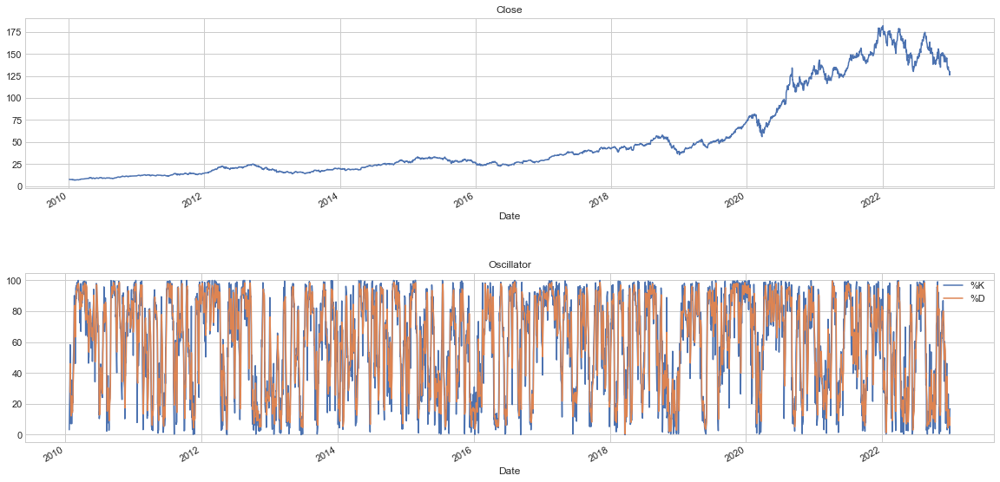

In [89]:
#create a plot (with 2 subplots) showing the AZN.L price over time, along with a visual representation of the Stochastic Oscillator.

fig, axes = plt.subplots(nrows=2, ncols=1,figsize=(20,10))
fig.subplots_adjust(hspace=0.5)

aapl_so['Close'].plot(ax=axes[0]); axes[0].set_title('Close')
aapl_so[['%K','%D']].plot(ax=axes[1]); axes[1].set_title('Oscillator');

In [90]:
# Create a column in the DataFrame showing "TRUE" if sell entry signal is given and "FALSE" otherwise.
# A sell is initiated when the %K line crosses down through the %D line and the value of the oscillator is above 80
aapl_so['Sell Entry'] = ((aapl_so['%K'] < aapl_so['%D']) & (aapl_so['%K'].shift(1) > aapl_so['%D'].shift(1))) & (aapl_so['%D'] > 80)

# Create a column in the DataFrame showing "TRUE" if sell exit signal is given and "FALSE" otherwise.
# A sell exit signal is given when the %K line crosses back up through the %D line
aapl_so['Sell Exit'] = ((aapl_so['%K'] > aapl_so['%D']) & (aapl_so['%K'].shift(1) < aapl_so['%D'].shift(1)))

# Create a placeholder column to populate with short positions (-1 for short and 0 for flat) using boolean values created above
aapl_so['Short'] = np.nan
aapl_so.loc[aapl_so['Sell Entry'], 'Short'] = -1
aapl_so.loc[aapl_so['Sell Exit'], 'Short'] = 0

# Set initial position on day 1 to flat
aapl_so['Short'][0] = 0

# Forward fill the position column to represent the holding of positions through time
aapl_so['Short'] = aapl_so['Short'].fillna(method='pad')

# Create a column in the DataFrame showing "TRUE" if buy entry signal is given and "FALSE" otherwise.
# A buy is initiated when the %K line crosses up through the %D line and the value of the oscillator is below 20
aapl_so['Buy Entry'] = ((aapl_so['%K'] > aapl_so['%D']) & (aapl_so['%K'].shift(1) < aapl_so['%D'].shift(1))) & (aapl_so['%D'] < 20)

# Create a column in the DataFrame showing "TRUE" if buy exit signal is given and "FALSE" otherwise.
# A buy exit signal is given when the %K line crosses back down through the %D line
aapl_so['Buy Exit'] = ((aapl_so['%K'] < aapl_so['%D']) & (aapl_so['%K'].shift(1) > aapl_so['%D'].shift(1)))

# Create a placeholder column to populate with long positions (1 for long and 0 for flat) using boolean values created above
aapl_so['Long'] = np.nan
aapl_so.loc[aapl_so['Buy Entry'], 'Long'] = 1
aapl_so.loc[aapl_so['Buy Exit'], 'Long'] = 0

# Set initial position on day 1 to flat
aapl_so['Long'][0] = 0

# Forward fill the position column to represent the holding of positions through time
aapl_so['Long'] = aapl_so['Long'].fillna(method='pad')

#Add Long and Short positions together to get final strategy position (1 for long, -1 for short and 0 for flat) 
aapl_so['Position'] = aapl_so['Long'] + aapl_so['Short']

In [91]:
fig = px.line(aapl_so, x=aapl_so.index, y='Position', title='Position Over Time')
fig.update_xaxes(title_text='Date')
fig.update_yaxes(title_text='Position')
fig.update_layout(width=1200, height=600)  # Adjust the width and height as needed

fig.show()

In [92]:
# Set up a column holding the daily AAPL returns
aapl_so['Market Returns'] = aapl_so['Close'].pct_change()

# Create a column for Strategy Returns by multiplying the daily AAPL returns by the position that was held at close
# of business the previous day
aapl_so['Strategy Returns'] = aapl_so['Market Returns'] * aapl_so['Position'].shift(1)

# Create a new DataFrame for cumulative returns
cumulative_returns = aapl_so[['Strategy Returns', 'Market Returns']].cumsum()

# Create a Plotly figure
fig = go.Figure()

# Add traces for Strategy Returns and Market Returns
fig.add_trace(go.Scatter(x=aapl_so.index, y=cumulative_returns['Strategy Returns'], mode='lines', name='Strategy Returns'))
fig.add_trace(go.Scatter(x=aapl_so.index, y=cumulative_returns['Market Returns'], mode='lines', name='Market Returns'))

# Customize the layout
fig.update_layout(
    title='Strategy Returns versus AAPL Returns',
    xaxis_title='Date',
    yaxis_title='Cumulative Returns',
    width=1200,
    height=600,
    legend=dict(x=0.02, y=0.98)  # Adjust the legend position
)

# Show the figure

This example again shows that despite the strategy having a positive return, we could have significantly improved our returns by just holding AAPL stock

In [93]:
# Calculate L14 and H14
aapl_so['L14'] = aapl_so['Low'].rolling(window=14).min()
aapl_so['H14'] = aapl_so['High'].rolling(window=14).max()

# Calculate %K and %D
aapl_so['%K'] = 100 * ((aapl_so['Close'] - aapl_so['L14']) / (aapl_so['H14'] - aapl_so['L14']))
aapl_so['%D'] = aapl_so['%K'].rolling(window=3).mean()

# Define conditions for buy and sell signals
sell_condition = ((aapl_so['%K'] < aapl_so['%D']) & (aapl_so['%K'].shift(1) > aapl_so['%D'].shift(1))) & (aapl_so['%D'] > 80)
buy_condition = ((aapl_so['%K'] > aapl_so['%D']) & (aapl_so['%K'].shift(1) < aapl_so['%D'].shift(1))) & (aapl_so['%D'] < 20)

# Create a "Position" column
aapl_so['Position'] = np.nan

# Set positions for sell and buy signals
aapl_so.loc[sell_condition, 'Position'] = -1
aapl_so.loc[buy_condition, 'Position'] = 1

# Set the initial position to flat (i.e., 0)
aapl_so['Position'].iloc[0] = 0

# Forward fill the position column
aapl_so['Position'] = aapl_so['Position'].fillna(method='ffill')

# Calculate daily returns for AAPL
aapl_so['Market Returns'] = aapl_so['Close'].pct_change()

# Calculate Strategy Returns
aapl_so['Strategy Returns'] = aapl_so['Market Returns'] * aapl_so['Position'].shift(1)

# Create a Plotly figure
fig = go.Figure()

# Add traces for Strategy Returns and Market Returns
fig.add_trace(go.Scatter(x=aapl_so.index, y=aapl_so['Strategy Returns'].cumsum(), mode='lines', name='Strategy Returns'))
fig.add_trace(go.Scatter(x=aapl_so.index, y=aapl_so['Market Returns'].cumsum(), mode='lines', name='Market Returns'))

# Customize the layout
fig.update_layout(
    title='Strategy returns versus AAPL returns (long or short)',
    xaxis_title='Date',
    yaxis_title='Cumulative Returns',
    width=1200,
    height=600,
    legend=dict(x=0.02, y=0.98)
)

# Show the figure
fig.show()

This adaptation of the strategy makes the returns negative and far far worse (in this case).

## 6.2.4 Rate of Change (ROC)
The ROC indicator serves as a straightforward momentum oscillator. In its computation, it assesses the present price in relation to its value "n" periods earlier. For instance, when we calculate the ROC using a 9-day lag on daily prices, it provides insight into the percentage increase or decrease in price over those 9 days. Similar to various other momentum indicators, ROC features zones indicative of overbought and oversold conditions, which can be adapted to suit prevailing market dynamics.

In [94]:
aapl_roc = aapl.copy()
aapl_roc

,Open,High,Low,Close,Adj Close,Volume
Date,,,,,,
2010-01-04,7.622500,7.660714,7.585000,7.643214,6.487534,493729600
2010-01-05,7.664286,7.699643,7.616071,7.656429,6.498750,601904800
2010-01-06,7.656429,7.686786,7.526786,7.534643,6.395380,552160000
2010-01-07,7.562500,7.571429,7.466071,7.520714,6.383554,477131200
2010-01-08,7.510714,7.571429,7.466429,7.570714,6.425996,447610800
...,...,...,...,...,...,...
2022-12-23,130.919998,132.419998,129.639999,131.860001,131.299820,63814900
2022-12-27,131.380005,131.410004,128.720001,130.029999,129.477600,69007800
2022-12-28,129.669998,131.029999,125.870003,126.040001,125.504539,85438400


In [95]:
aapl_roc_12mo = aapl_roc['2020-01-01':'2020-12-31']
aapl_roc_12mo 

,Open,High,Low,Close,Adj Close,Volume
Date,,,,,,
2020-01-02,74.059998,75.150002,73.797501,75.087502,73.249023,135480400
2020-01-03,74.287498,75.144997,74.125000,74.357498,72.536896,146322800
2020-01-06,73.447502,74.989998,73.187500,74.949997,73.114891,118387200
2020-01-07,74.959999,75.224998,74.370003,74.597504,72.771011,108872000
2020-01-08,74.290001,76.110001,74.290001,75.797501,73.941628,132079200
...,...,...,...,...,...,...
2020-12-24,131.320007,133.460007,131.100006,131.970001,129.850571,54930100
2020-12-28,133.990005,137.339996,133.509995,136.690002,134.494781,124486200
2020-12-29,138.050003,138.789993,134.339996,134.869995,132.703995,121047300


In [96]:
aapl_roc_12mo['ROC'] = ( aapl_roc_12mo['Adj Close'] / aapl_roc_12mo['Adj Close'].shift(9) -1 ) * 100
aapl_roc_12mo[['Adj Close', 'ROC']]

,Adj Close,ROC
Date,,
2020-01-02,73.249023,NaN
2020-01-03,72.536896,NaN
2020-01-06,73.114891,NaN
2020-01-07,72.771011,NaN
2020-01-08,73.941628,NaN
...,...,...
2020-12-24,129.850571,7.809816
2020-12-28,134.494781,12.243396
2020-12-29,132.703995,5.466060


In [97]:
# selection of data - last 100 days

aapl_roc_100d = aapl_roc_12mo[-100:]
dates = aapl_roc_100d.index
price = aapl_roc_100d['Adj Close']
roc = aapl_roc_100d['ROC']

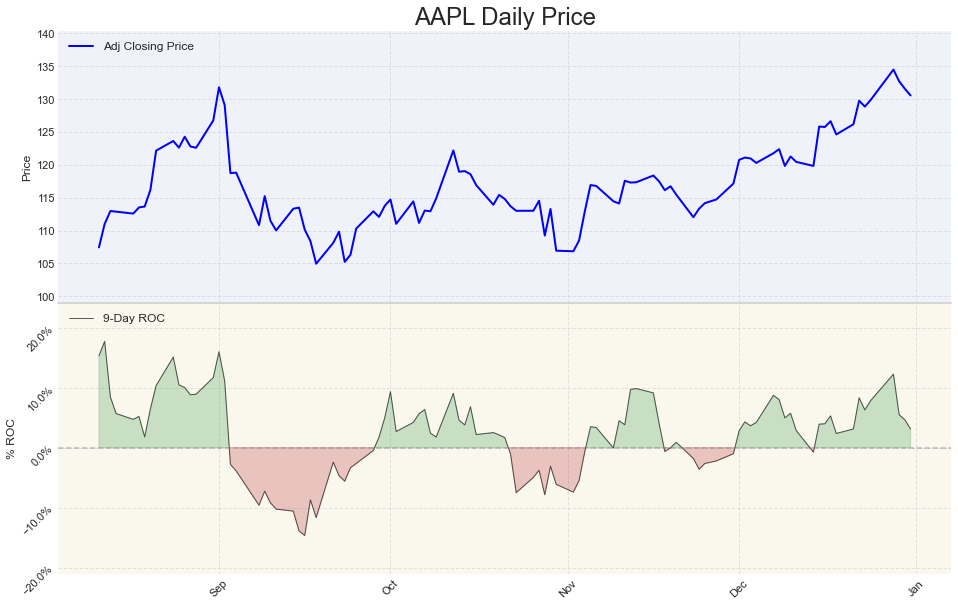

In [98]:
# Plot AZN.L Adj Close Price and 9-day ROC for last 100 days of 2019

fig = plt.figure(figsize=(16,10))
fig.subplots_adjust(hspace=0)

plt.rcParams.update({'font.size': 14})

# Price subplot
price_ax = plt.subplot(2, 1, 1)
price_ax.plot(dates, price, color='blue', linewidth=2, label="Adj Closing Price")
price_ax.legend(loc="upper left", fontsize=12)
price_ax.set_ylabel("Price")
price_ax.set_title("AAPL Daily Price", fontsize=24)

# ROC subplot
roc_ax = plt.subplot(2, 1, 2, sharex = price_ax)
roc_ax.plot(roc, color='k', linewidth = 1, alpha=0.7, label="9-Day ROC")
roc_ax.legend(loc="upper left", fontsize=12)
roc_ax.set_ylabel("% ROC")

# Adding a horizontal line at the zero level in the ROC subplot:
roc_ax.axhline(0, color = (.5, .5, .5), linestyle = '--', alpha = 0.5)

# Filling the areas between the indicator and the level 0 line:
roc_ax.fill_between(dates, 0, roc, where = (roc >= 0), color='g', alpha=0.3, interpolate=True)
roc_ax.fill_between(dates, 0, roc, where = (roc  < 0), color='r', alpha=0.3, interpolate=True)

# Formatting the date labels
roc_ax.xaxis.set_major_formatter(DateFormatter('%b'))

# Formatting the labels on the y axis for ROC:
roc_ax.yaxis.set_major_formatter(mpl.ticker.PercentFormatter())

# Adding a grid to both subplots:
price_ax.grid(b=True, linestyle='--', alpha=0.5)
roc_ax.grid(b=True, linestyle='--', alpha=0.5)

# Setting a background color for the both subplots:
price_ax.set_facecolor((.94,.95,.98))
roc_ax.set_facecolor((.98,.97,.93))

# Adding margins around the plots:
price_ax.margins(0.05, 0.2)
roc_ax.margins(0.05, 0.2)

# Hiding the tick marks from the horizontal and vertical axis:
price_ax.tick_params(left=False, bottom=False)
roc_ax.tick_params(left=False, bottom=False, labelrotation=45)

# Hiding all the spines for the price subplot:
for s in price_ax.spines.values():
    s.set_visible(False)
# Hiding all the spines for the ROC subplot:
for s in roc_ax.spines.values():
    s.set_visible(False)

# To better separate the two subplots, we reinstate a spine in between them
roc_ax.spines['top'].set_visible(True)
roc_ax.spines['top'].set_linewidth(1.5)

In [99]:

# Create a figure for candlestick and volume plot
fig = go.Figure()

# Candlestick trace
fig.add_trace(go.Candlestick(
    x=roc.index,
    open=aapl_roc_100d['Open'],
    high=aapl_roc_100d['High'],
    low=aapl_roc_100d['Low'],
    close=aapl_roc_100d['Close'],
    name='Candlestick',
))

# Volume trace
fig.add_trace(go.Bar(
    x=aapl_roc_100d.index,
    y=aapl_roc_100d['Volume'],
    name='Volume',
    marker_color='blue',
    opacity=0.5,
    yaxis='y2',
))

# Customize the layout
fig.update_layout(
    title='AAPL Daily Price and Volume',
    xaxis_title='Date',
    yaxis_title='Price',
    yaxis2=dict(
        title='Volume',
        overlaying='y',
        side='right',  # Place the second y-axis on the right side
    ),
    xaxis_rangeslider_visible=False,
    height=600,
)

# Show the plot
fig.show()


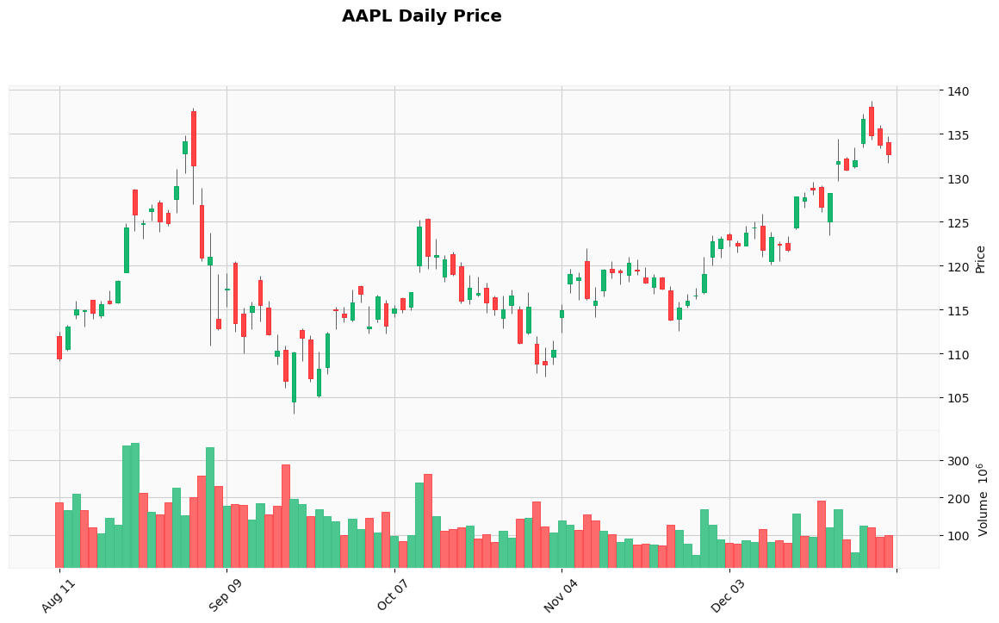

In [100]:
# Candlestick and volume plot for same time frame

mpf.plot(aapl_roc_100d, type='candle',  style='yahoo', figsize=(15,8),  title="AAPL Daily Price", volume=True)


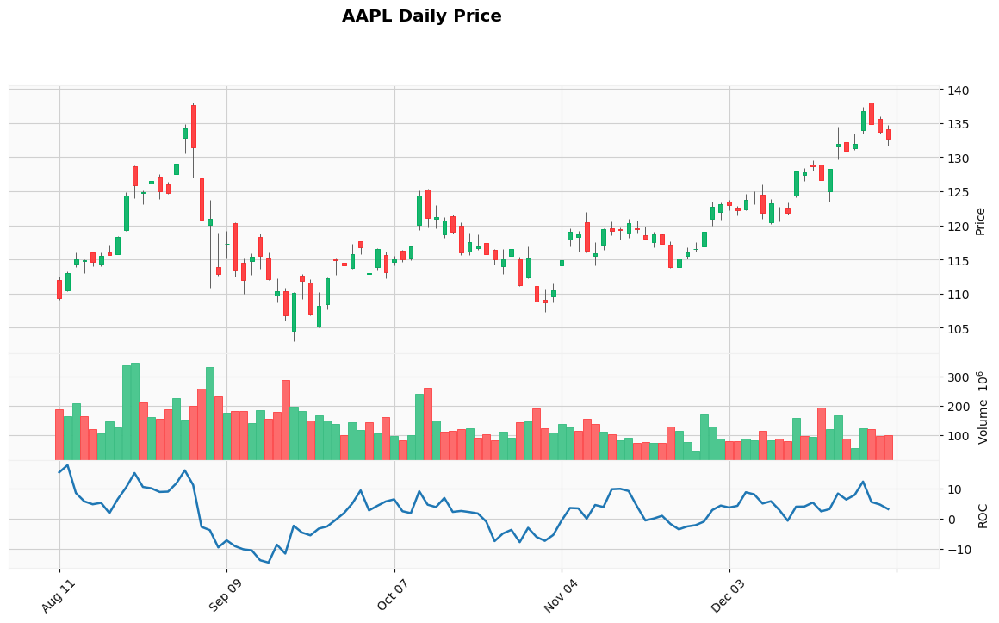

In [101]:
# Combined Candlestick, ROC and Volume plot

# We create an additional plot planing it on the third panel
roc_plot = mpf.make_addplot(roc, panel=2, ylabel='ROC')

#We pass the additional plot using the addplot parameter
mpf.plot(aapl_roc_100d, type='candle',  style='yahoo', figsize=(15,8), addplot=roc_plot, title="AAPL Daily Price", volume=True)

## 6.3 Volatility Trading Strategies
Volatility trading involves predicting the stability of an asset’s value. Traders take a position on whether it will move in any direction.

## 6.3.1 Bollinger Bands
A Bollinger Band serves as a volatility gauge that relies on the relationship between the normal distribution and stock prices, enabling the creation of support and resistance lines. It consists of lines drawn at two standard deviations, both positively and negatively, from a simple moving average (SMA) of the security's price. These parameters can be adjusted to suit the user's preferences.

By default, it computes a 20-period SMA as the middle band, an upper band positioned two standard deviations above the moving average, and a lower band set at two standard deviations below it.

When the price surpasses the upper band, it may suggest an opportune moment to consider selling, while dropping below the lower band could indicate a favorable time to contemplate buying.

In contrast to the Relative Strength Index (RSI), which is primarily useful in ranging markets and not trending ones, Bollinger Bands allow us to calculate the expanding factor, or the changing spread between the upper and lower bands. This information helps determine if prices are potentially entering a trending phase and whether RSI signals may lose their reliability.

However, it's important to note that despite approximately 90% of price movements occurring within the bands, a breakout alone doesn't provide sufficient guidance regarding the direction and extent of future price movements, making it less of a trading signal.

In [102]:
aapl_12mo

,Open,High,Low,Close,Adj Close,Volume
Date,,,,,,
2020-01-02,74.059998,75.150002,73.797501,75.087502,73.249023,135480400
2020-01-03,74.287498,75.144997,74.125000,74.357498,72.536896,146322800
2020-01-06,73.447502,74.989998,73.187500,74.949997,73.114891,118387200
2020-01-07,74.959999,75.224998,74.370003,74.597504,72.771011,108872000
2020-01-08,74.290001,76.110001,74.290001,75.797501,73.941628,132079200
...,...,...,...,...,...,...
2021-12-27,177.089996,180.419998,177.070007,180.330002,178.527771,74919600
2021-12-28,180.160004,181.330002,178.529999,179.289993,177.498138,79144300
2021-12-29,179.330002,180.630005,178.139999,179.380005,177.587265,62348900


In [103]:
aapl_12mo_bb = aapl_12mo.copy()
aapl_12mo_bb

,Open,High,Low,Close,Adj Close,Volume
Date,,,,,,
2020-01-02,74.059998,75.150002,73.797501,75.087502,73.249023,135480400
2020-01-03,74.287498,75.144997,74.125000,74.357498,72.536896,146322800
2020-01-06,73.447502,74.989998,73.187500,74.949997,73.114891,118387200
2020-01-07,74.959999,75.224998,74.370003,74.597504,72.771011,108872000
2020-01-08,74.290001,76.110001,74.290001,75.797501,73.941628,132079200
...,...,...,...,...,...,...
2021-12-27,177.089996,180.419998,177.070007,180.330002,178.527771,74919600
2021-12-28,180.160004,181.330002,178.529999,179.289993,177.498138,79144300
2021-12-29,179.330002,180.630005,178.139999,179.380005,177.587265,62348900


In [104]:
# Get the time period (20 days)
period = 20

# Calculate the 20 Day Simple Moving Average, Std Deviation, Upper Band, and Lower Band
# Calculating the Simple Moving Average
aapl_12mo_bb['SMA'] = aapl_12mo_bb['Close'].rolling(window=period).mean()

# Get the standard deviation
aapl_12mo_bb['STD'] = aapl_12mo_bb['Close'].rolling(window=period).std()

# Calculate the Upper Bollinger Band
aapl_12mo_bb['Upper'] = aapl_12mo_bb['SMA'] + (aapl_12mo_bb['STD'] * 2)

# Calculate the Lower Bollinger Band
aapl_12mo_bb['Lower'] = aapl_12mo_bb['SMA'] - (aapl_12mo_bb['STD'] * 2)

# Create a list of columns to keep
column_list = ['Close', 'SMA', 'Upper', 'Lower']


In [105]:
def bb_12mo():
    fig = go.Figure()

    # Plot Close, Upper, and Lower Bollinger Bands using Scatter mode
    fig.add_trace(go.Scatter(x=aapl_12mo_bb.index, y=aapl_12mo_bb['Close'], mode='lines', name='Close'))
    fig.add_trace(go.Scatter(x=aapl_12mo_bb.index, y=aapl_12mo_bb['Upper'], mode='lines', name='Upper Bollinger Band'))
    fig.add_trace(go.Scatter(x=aapl_12mo_bb.index, y=aapl_12mo_bb['Lower'], mode='lines', name='Lower Bollinger Band'))

    # Customize the layout
    fig.update_layout(
        title='Bollinger Band for AAPL',
        xaxis_title='Date',
        yaxis_title='Close Price',
        showlegend=True,
        height=600,
        width=1000,
    )

    # Show the plot
    fig.show()

bb_12mo()


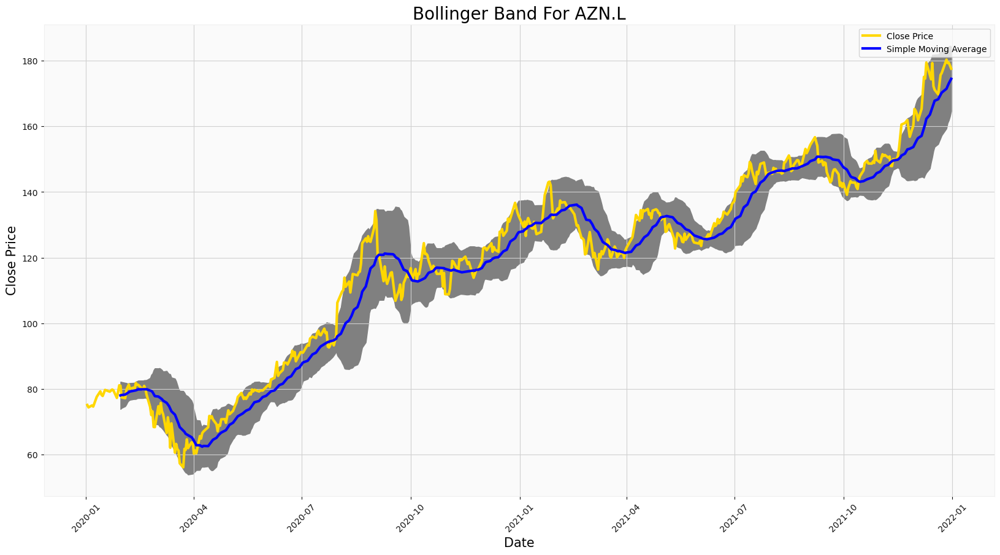

In [106]:
#Plot and shade the area between the two Bollinger bands

def bb_shaded():
  #Get the figure and the figure size
  fig = plt.figure(figsize=(20,10)) 

  #Add the subplot
  ax = fig.add_subplot(1,1,1) #Number of rows, cols, & index

  # Get the index values of the DataFrame
  x_axis = aapl_12mo_bb.index

  # Plot and shade the area between the upper band and the lower band Grey
  ax.fill_between(x_axis, aapl_12mo_bb['Upper'], aapl_12mo_bb['Lower'], color='grey')

  # Plot the Closing Price and Moving Average
  ax.plot(x_axis, aapl_12mo_bb['Close'], color='gold', lw=3, label = 'Close Price') #lw = line width
  ax.plot(x_axis, aapl_12mo_bb['SMA'], color='blue', lw=3, label = 'Simple Moving Average')

  # Set the Title & Show the Image
  ax.set_title('Bollinger Band For AZN.L', color = 'black', fontsize = 20)
  ax.set_xlabel('Date', color = 'black', fontsize = 15)
  ax.set_ylabel('Close Price', color = 'black', fontsize = 15)
  plt.xticks(rotation = 45)
  ax.legend()
  plt.show();

bb_shaded()

In [107]:
#Create a new data frame
new_aapl_12mo_bb = aapl_12mo_bb[period-1:]
#Show the new data frame
new_aapl_12mo_bb


# Create a function to get the buy and sell signals
def get_signal_bb(data):
  buy_signal = [] #buy list
  sell_signal = [] #sell list

  for i in range(len(data['Close'])):
      if data['Close'][i] > data['Upper'][i]: #Then you should sell 
        buy_signal.append(np.nan)
        sell_signal.append(data['Close'][i])
      elif data['Close'][i] < data['Lower'][i]: #Then you should buy
        sell_signal.append(np.nan)
        buy_signal.append(data['Close'][i])
      else:
        buy_signal.append(np.nan)
        sell_signal.append(np.nan)
  return (buy_signal, sell_signal)

In [108]:
#Create new columns for the buy and sell signals
new_aapl_12mo_bb['Buy'] = get_signal_bb(new_aapl_12mo_bb)[0]
new_aapl_12mo_bb['Sell'] = get_signal_bb(new_aapl_12mo_bb)[1]

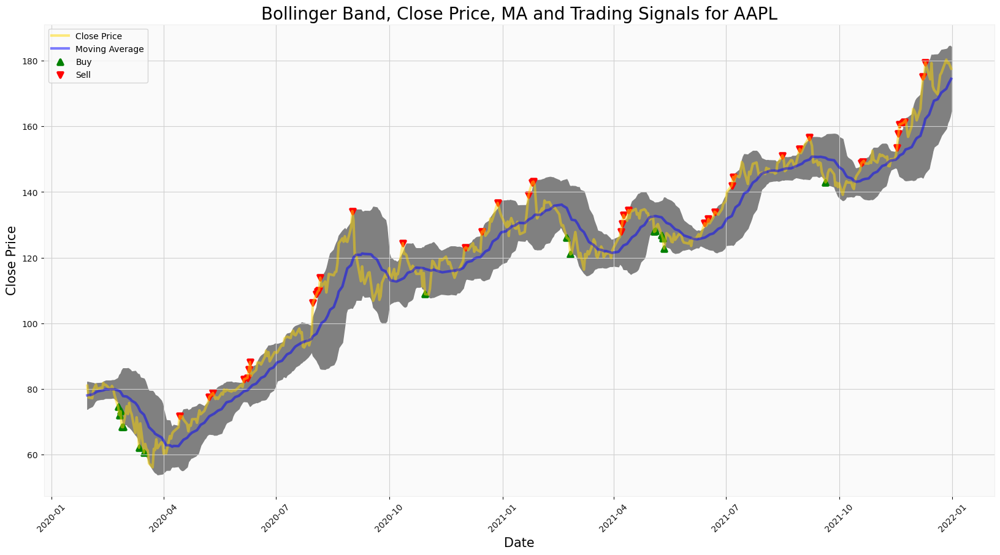

In [109]:
# Plot all of the data

def bb_alldata():
    # Get the figure and the figure size
    fig = plt.figure(figsize=(20, 10))

    # Add the subplot
    ax = fig.add_subplot(1, 1, 1)  # Number of rows, cols, & index

    # Get the index values of the DataFrame
    x_axis = new_aapl_12mo_bb.index

    # Plot and shade the area between the upper band and the lower band Grey
    ax.fill_between(x_axis, new_aapl_12mo_bb['Upper'], new_aapl_12mo_bb['Lower'], color='grey')

    # Plot the Closing Price and Moving Average
    ax.plot(x_axis, new_aapl_12mo_bb['Close'], color='gold', lw=3, label='Close Price', alpha=0.5)
    ax.plot(x_axis, new_aapl_12mo_bb['SMA'], color='blue', lw=3, label='Moving Average', alpha=0.5)
    ax.scatter(x_axis, new_aapl_12mo_bb['Buy'], color='green', lw=3, label='Buy', marker='^', alpha=1)
    ax.scatter(x_axis, new_aapl_12mo_bb['Sell'], color='red', lw=3, label='Sell', marker='v', alpha=1)

    # Set the Title & Show the Image
    ax.set_title('Bollinger Band, Close Price, MA and Trading Signals for AAPL', color='black', fontsize=20)
    ax.set_xlabel('Date', color='black', fontsize=15)
    ax.set_ylabel('Close Price', color='black', fontsize=15)
    plt.xticks(rotation=45)
    ax.legend()
    plt.show()

bb_alldata()


## 6.3.2 Mean Reversion Strategies
We exploit when it deviates from the mean value

Typically, these strategies entail selling during market upswings and buying during market downturns. This contrarian approach is based on the assumption that when the market is oversold or overbought, prices will eventually return to their historical patterns. It stands in stark contrast to trend-following strategies, where we enter trades aligned with market strength and momentum. Momentum strategies involve buying stocks that have been consistently trending upward, with the expectation that the prevailing trend will persist. In essence, these approaches represent opposing viewpoints, one focusing on reversals and the other on continuations.

In [110]:
dow_jones_stock_pairs = dow_jones_stock.copy()
dow_jones_stock_pairs

GS                                                  \
                  Open        High         Low       Close   Adj Close   
Date                                                                     
2010-01-04  170.050003  174.250000  169.509995  173.080002  137.658066   
2010-01-05  173.000000  176.259995  172.570007  176.139999  140.091858   
2010-01-06  175.380005  175.380005  173.759995  174.259995  138.596680   
2010-01-07  174.320007  178.750000  173.949997  177.669998  141.308746   
2010-01-08  176.330002  177.429993  173.949997  174.309998  138.636414   
...                ...         ...         ...         ...         ...   
2022-12-23  344.839996  347.760010  343.109985  345.510010  337.645844   
2022-12-27  346.510010  347.750000  341.790009  341.970001  334.186462   
2022-12-28  340.500000  342.850006  339.299988  340.869995  333.111450   
2022-12-29  342.440002  344.640015  341.239990  343.429993  335.613220   
2022-12-30  341.739990  343.690002  339.399994  343.380005  335.564362   

                             MMM                                      ...  \
              Volume        Open        High         Low       Close  ...   
Date                                                                  ...   
2010-01-04   9135000   83.089996   83.449997   82.669998   83.019997  ...   
2010-01-05  11659400   82.800003   83.230003   81.699997   82.500000  ...   
2010-01-06   7381100   83.879997   84.599998   83.510002   83.669998  ...   
2010-01-07   8727400   83.320000   83.760002   82.120003   83.730003  ...   
2010-01-08   7268100   83.690002   84.320000   83.300003   84.320000  ...   
...              ...         ...         ...         ...         ...  ...   
2022-12-23   1062000  120.790001  121.000000  117.800003  120.139999  ...   
2022-12-27   1035000  120.139999  120.830002  119.160004  120.220001  ...   
2022-12-28   1117200  120.349998  121.000000  118.250000  118.290001  ...   
2022-12-29   1273600  118.870003  120.860001  118.500000  120.570000  ...   
2022-12-30   1031400  119.650002  120.029999  118.510002  119.919998  ...   

                   CRM                                        CSCO             \
                   Low       Close   Adj Close   Volume       Open       High   
Date                                                                            
2010-01-04   18.547501   18.705000   18.705000  7906000  24.110001  24.840000   
2010-01-05   18.200001   18.625000   18.625000  7942400  24.600000  24.730000   
2010-01-06   18.495001   18.592501   18.592501  5122400  24.540001  24.740000   
2010-01-07   18.385000   18.510000   18.510000  4840000  24.299999  24.570000   
2010-01-08   18.315001   18.537500   18.537500  5510400  24.379999  24.700001   
...                ...         ...         ...      ...        ...        ...   
2022-12-23  127.589996  129.440002  129.440002  5821300  47.250000  47.490002   
2022-12-27  127.650002  130.660004  130.660004  8300800  47.669998  47.709999   
2022-12-28  128.169998  128.470001  128.470001  6249800  47.689999  47.770000   
2022-12-29  129.500000  132.539993  132.539993  7628800  47.259998  47.740002   
2022-12-30  130.360001  132.589996  132.589996  5630200  47.270000  47.669998   

                                                       
                  Low      Close  Adj Close    Volume  
Date                                                   
2010-01-04  24.010000  24.690001  17.011654  59853700  
2010-01-05  24.379999  24.580000  16.935858  45124500  
2010-01-06  24.340000  24.420000  16.825617  35715700  
2010-01-07  24.170000  24.530001  16.901411  31531200  
2010-01-08  24.250000  24.660000  16.990982  39115900  
...               ...        ...        ...       ...  
2022-12-23  47.009998  47.480000  46.067886   9554400  
2022-12-27  47.220001  47.529999  46.116398  12066200  
2022-12-28  46.980000  47.070000  45.670082   9847400  
2022-12-29  47.259998  47.500000  46.087299  11396500  
2022-12-30  46.950001  47.639999  46.2231

In [111]:
# Concise summary of the dataframe

dow_jones_stock_pairs.info(null_counts=True)
dow_jones_stock.describe()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 3272 entries, 2010-01-04 to 2022-12-30
Columns: 180 entries, ('GS', 'Open') to ('CSCO', 'Volume')
dtypes: float64(151), int64(29)
memory usage: 4.6 MB


GS                                                      \
              Open         High          Low        Close    Adj Close   
count  3272.000000  3272.000000  3272.000000  3272.000000  3272.000000   
mean    205.015682   207.154960   202.849768   205.007466   181.556986   
std      74.000556    74.730986    73.177336    73.967808    75.892783   
min      88.059998    89.279999    84.269997    87.699997    71.112564   
25%     157.102501   158.927494   155.437504   157.244999   130.769409   
50%     189.279999   190.740005   187.290001   189.169998   162.564369   
75%     234.070007   235.845001   231.770004   233.792500   208.065796   
max     423.119995   426.160004   413.760010   423.850006   401.437286   

                             MMM                                         ...  \
             Volume         Open         High          Low        Close  ...   
count  3.272000e+03  3272.000000  3272.000000  3272.000000  3272.000000  ...   
mean   4.151375e+06   147.968279   149.083447   146.772204   147.966412  ...   
std    3.946064e+06    43.938280    44.210023    43.628343    43.915662  ...   
min    4.677000e+05    70.129997    72.180000    68.629997    70.930000  ...   
25%    2.369475e+06   105.699999   106.152498   105.129999   105.740000  ...   
50%    3.153700e+06   155.085007   156.564995   153.894997   155.395004  ...   
75%    4.644675e+06   178.347496   179.465004   177.220001   178.392498  ...   
max    1.020437e+08   258.510010   259.769989   255.970001   258.630005  ...   

               CRM                                                 CSCO  \
               Low        Close    Adj Close        Volume         Open   
count  3272.000000  3272.000000  3272.000000  3.272000e+03  3272.000000   
mean    102.008559   103.409431   103.409431  6.910582e+06    33.498090   
std      70.263135    71.204781    71.204781  5.048138e+06    12.644248   
min      15.075000    15.520000    15.520000  1.084700e+06    13.930000   
25%      41.862499    42.396875    42.396875  4.056725e+06    22.910000   
50%      75.704998    76.275002    76.275002  5.549200e+06    29.510000   
75%     152.930000   155.182495   155.182495  8.116575e+06    45.000000   
max     307.250000   309.959991   309.959991  6.456280e+07    64.040001   

                                                                         
              High          Low        Close    Adj Close        Volume  
count  3272.000000  3272.000000  3272.000000  3272.000000  3.272000e+03  
mean     33.808252    33.190923    33.506583    28.000614  3.269060e+07  
std      12.760669    12.525607    12.647221    13.293068  2.570796e+07  
min      14.120000    13.300000    13.730000     9.529293  5.720500e+06  
25%      23.129999    22.629999    22.889999    16.359600  1.876142e+07  
50%      29.780001    29.360000    29.545000    23.055949  2.548035e+07  
75%      45.500000    44.542500    44.967500    40.552784  3.917035e+07  
max      64.290001    63.549999    63.959999    60.169128  5.600402e+08  

[8 rows x 180 columns]

In [112]:
# Initialize an empty DataFrame for close prices
dow_jones_stock_close = pd.DataFrame()

# Iterate through the stock tickers and extract the 'Close' data
for ticker in tickers:
    close_data = dow_jones_stock_pairs[ticker]['Close']
    dow_jones_stock_close[ticker] = close_data

# Now, dow_jones_stock_close contains the 'Close' data for each stock ticker
dow_jones_stock_close

,MMM,AXP,AMGN,AAPL,BA,CAT,CVX,CSCO,KO,DIS,...,MSFT,NKE,PG,CRM,TRV,UNH,VZ,V,WBA,WMT
Date,,,,,,,,,,,,,,,,,,,,,
2010-01-04,83.019997,40.919998,57.720001,7.643214,56.180000,58.549999,79.059998,24.690001,28.520000,32.070000,...,30.950001,16.337500,61.119999,18.705000,49.810001,31.530001,31.212946,22.035000,37.299999,54.230000
2010-01-05,82.500000,40.830002,57.220001,7.656429,58.020000,59.250000,79.620003,24.580000,28.174999,31.990000,...,30.959999,16.402500,61.139999,18.625000,48.630001,31.480000,31.269218,21.782499,37.000000,53.689999
2010-01-06,83.669998,41.490002,56.790001,7.534643,59.779999,59.430000,79.629997,24.420000,28.165001,31.820000,...,30.770000,16.302500,60.849998,18.592501,47.939999,31.790001,29.937416,21.490000,36.720001,53.570000
2010-01-07,83.730003,41.980000,56.270000,7.520714,62.200001,59.669998,79.330002,24.530001,28.094999,31.830000,...,30.450001,16.462500,60.520000,18.510000,48.630001,33.009998,29.759218,21.690001,36.939999,53.599998
2010-01-08,84.320000,41.950001,56.770000,7.570714,61.599998,60.340000,79.470001,24.660000,27.575001,31.879999,...,30.660000,16.430000,60.439999,18.537500,48.560001,32.700001,29.777975,21.750000,36.990002,53.330002
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2022-12-23,120.139999,147.020004,263.920013,131.860001,189.059998,239.869995,177.399994,47.480000,63.820000,88.010002,...,238.729996,116.250000,152.619995,129.440002,189.479996,531.309998,38.410000,205.830002,38.630001,143.770004
2022-12-27,120.220001,146.389999,263.390015,130.029999,189.399994,243.139999,179.630005,47.529999,64.209999,86.370003,...,236.960007,117.559998,153.949997,130.660004,190.479996,531.989990,39.250000,206.289993,38.310001,143.809998
2022-12-28,118.290001,144.009995,261.420013,126.040001,188.380005,239.380005,176.979996,47.070000,63.570000,84.169998,...,234.529999,114.980003,151.960007,128.470001,188.130005,528.450012,38.810001,204.990005,37.580002,141.289993


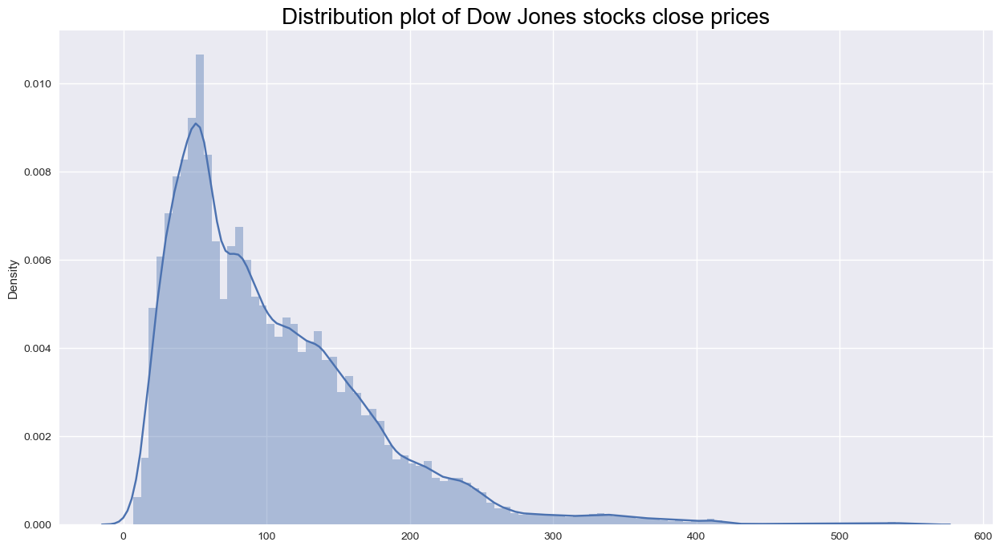

In [113]:
# Distribution plot of close prices

def dist_plt():
  plt.style.use('seaborn')
  plt.figure(figsize=(15, 8))
  plt.title("Distribution plot of Dow Jones stocks close prices", color = 'black', fontsize = 20)
  sns.distplot(dow_jones_stock_close, bins=100, kde=True);

dist_plt()

In [114]:
def ftse_close():
    fig = px.line(dow_jones_stock_close, x=dow_jones_stock_close.index, y=dow_jones_stock_close.columns, title='Dow Jones stocks Close Price')
    fig.update_layout(title_font=dict(size=20), xaxis_title="Year", yaxis_title="Close Price", font=dict(size=15))
    fig.show()

ftse_close()


## Correlation
Calculating the strength and direaction of the linear relationship between pairs of stocks - correlation.

In [115]:
np.corrcoef(dow_jones_stock_close['AAPL'],dow_jones_stock_close['IBM'])

array([[ 1.        , -0.49896887],
       [-0.49896887,  1.        ]])

In [116]:
# compute the correlations between every pair of stocks
correlation_matrix = dow_jones_stock_close.corr() 
correlation_matrix

,MMM,AXP,AMGN,AAPL,BA,CAT,CVX,CSCO,KO,DIS,...,MSFT,NKE,PG,CRM,TRV,UNH,VZ,V,WBA,WMT
MMM,1.000000,0.546605,0.727432,0.367594,0.806035,0.458132,0.198627,0.685555,0.576825,0.779782,...,0.417352,0.587860,0.453390,0.601344,0.748265,0.519032,0.723944,0.614459,0.662823,0.487470
AXP,0.546605,1.000000,0.848307,0.902481,0.582646,0.896843,0.566673,0.877077,0.918610,0.824114,...,0.915705,0.908002,0.914842,0.875423,0.896039,0.922711,0.603385,0.912369,0.028488,0.912428
AMGN,0.727432,0.848307,1.000000,0.812660,0.653908,0.756311,0.385965,0.865091,0.905796,0.884304,...,0.830383,0.884275,0.876826,0.871482,0.928428,0.894875,0.742885,0.935964,0.265774,0.882334
AAPL,0.367594,0.902481,0.812660,1.000000,0.349409,0.904367,0.397976,0.797932,0.857059,0.730581,...,0.983997,0.926199,0.946206,0.893181,0.796580,0.954106,0.444498,0.904327,-0.184695,0.929664
BA,0.806035,0.582646,0.653908,0.349409,1.000000,0.503416,0.292019,0.781656,0.579188,0.688051,...,0.436110,0.560730,0.447692,0.616894,0.697056,0.533259,0.670911,0.658193,0.356298,0.521018
CAT,0.458132,0.896843,0.756311,0.904367,0.503416,1.000000,0.515683,0.804247,0.811746,0.703027,...,0.904284,0.860339,0.848943,0.847031,0.793772,0.904726,0.446443,0.864415,-0.174061,0.883019
CVX,0.198627,0.566673,0.385965,0.397976,0.292019,0.515683,1.000000,0.344647,0.589510,0.196346,...,0.353631,0.258182,0.400463,0.213244,0.554515,0.501551,0.227623,0.341990,0.034513,0.391983
CSCO,0.685555,0.877077,0.865091,0.797932,0.781656,0.804247,0.344647,1.000000,0.826184,0.854429,...,0.863234,0.898235,0.843449,0.907543,0.882638,0.880761,0.652060,0.939371,0.093155,0.860589
KO,0.576825,0.918610,0.905796,0.857059,0.579188,0.811746,0.589510,0.826184,1.000000,0.805871,...,0.861734,0.868520,0.915447,0.830929,0.934295,0.918166,0.694817,0.907022,0.122367,0.889129
DIS,0.779782,0.824114,0.884304,0.730581,0.688051,0.703027,0.196346,0.854429,0.805871,1.000000,...,0.770727,0.899516,0.800388,0.879616,0.864478,0.763918,0.802063,0.879502,0.358295,0.807743


In [117]:
# Mask the lower triangle of the correlation matrix to exclude 1.0 values
mask = np.triu(np.ones_like(correlation_matrix, dtype=bool))

# Extract the upper triangle of the correlation matrix
upper_triangle = correlation_matrix.mask(mask)

# Find the location of the maximum value in the upper triangle
max_location = upper_triangle.unstack().idxmax()

# Get the row and column labels associated with the maximum value
max_row_label, max_col_label = max_location

# Find the maximum value in the upper triangle (excluding 1.0)
max_correlation = upper_triangle.max().max()

print("Highest correlation value (excluding 1.0):", max_correlation)
print("Row Label:", max_row_label)
print("Column Label:", max_col_label)

Highest correlation value (excluding 1.0): 0.9839974389930095
Row Label: AAPL
Column Label: MSFT


In [118]:
def correlation_heatmap():
    fig = px.imshow(dow_jones_stock_close.corr(), color_continuous_scale="YlGnBu")
    fig.update_layout(title="Correlation Heatmap", title_font=dict(size=20))
    fig.update_xaxes(tickangle=45, title="Stocks")
    fig.update_yaxes(tickangle=45, title="Stocks")
    fig.show()

correlation_heatmap()


The most robust linear correlation, denoted by a coefficient of 0.9845, exists between AAPL and MSFT. This substantial value signifies a potent connection between these two stocks. Consequently, when the value of A rises, there is a notable likelihood that B will also experience an increase. Leveraging this insight, a market-neutral strategy is implemented. In this strategy, we purchase stock A while simultaneously selling stock B, making our buying and selling decisions based on the distinct patterns of each stock.

In [119]:
def stocks_aapl_msft():
    fig = px.line(title="AAPL and MSFT Close Prices for 2010-2023")
    
    fig.add_scatter(x=dow_jones_stock_close.index, y=dow_jones_stock_close['AAPL'], mode='lines', name='AAPL', line=dict(color='red'))
    fig.add_scatter(x=dow_jones_stock_close.index, y=dow_jones_stock_close['MSFT'], mode='lines', name='MSFT', line=dict(color='blue'))
    
    fig.update_xaxes(title_text='Year')
    fig.update_yaxes(title_text='Stock Price (p)')
    
    fig.show()

stocks_aapl_msft()


## Feature Extraction - Price Ratio
BY calculating the ratio of a stocks price to another we can determine how much of each to buy or sell.

In [120]:

ratios = dow_jones_stock_close['AAPL'] / dow_jones_stock_close['MSFT']

fig = px.line(title='Comparing Price Ratio ofAAPL to MSFT')
fig.add_scatter(x=ratios.index, y=ratios, mode='lines', name='Price Ratio')
fig.add_hline(y=ratios.mean(), line=dict(color='black', dash='dash'), name='Average Value')

fig.update_xaxes(title_text='Date')
fig.update_yaxes(title_text='Price Ratio')

fig.show()





when we deviate away from the mean at the furtherst points we would buy one stock and sell another.

## Feature scaling - Z-scores
A Z-score tells you how many standard-deviations you are away from the mean value. It is a measure of an obersvations variability so can be used to help determine market volatility. 

In [121]:
def z_scores_comparison():
    zscores = zscore(ratios)
    
    fig = px.line(title='Z Scores for the Ratio - AAPL and MSFT')
    fig.add_scatter(x=ratios.index, y=zscores, mode='lines', name='Z Scores')
    fig.add_hline(y=zscores.mean(), line=dict(color='black', dash='dash'), name='Average Value')

    fig.update_xaxes(title_text='Date')
    fig.update_yaxes(title_text='Z Scores')

    fig.show()

z_scores_comparison()


## Cointegration
The predominant test utilized in Pairs Trading is the cointegration test. Cointegration is a statistical attribute of two or more time-series variables that determines whether a linear combination of these variables remains stationary.

In simpler terms, it implies that the ratio we've calculated will eventually return to a mean value, instead of continuously rising or falling over time. While correlation represents the statistical inclination of two variables to move in sync, cointegration imposes a somewhat more rigorous condition.

In [122]:
# Augmented Dickey-Fuller test to check stationarity

def stationarity(a, cutoff = 0.05):
    a = np.ravel(a)
    if adfuller(a)[1] < cutoff:
      print('The series is stationary')
      print('p-value = ', adfuller(a)[1])
    else:
      print('The series is NOT stationary')
      print('p-value = ', adfuller(a)[1])

In [123]:
stationarity(dow_jones_stock_close['AAPL'])

The series is NOT stationary
p-value =  0.9272199267187228


In [124]:
stationarity(dow_jones_stock_close['MSFT'])

The series is NOT stationary
p-value =  0.9708976378738849


In [125]:
# Check cointegration

def cointegration(a, b):
    if coint(a, b)[1] < 0.05:
      print('The series are cointegrated')
      print('p-value = ', coint(a,b)[1])  
    else:
      print('The series are NOT cointegrated')
      print('p-value = ', coint(a,b)[1])  

In [126]:
cointegration(dow_jones_stock_close['AAPL'], dow_jones_stock_close['MSFT'])

The series are cointegrated
p-value =  0.020207054858193334


In [127]:
def stocks_AAPL_IBM():
    fig = px.line(dow_jones_stock_close, x=dow_jones_stock_close.index, y=[dow_jones_stock_close['AAPL'], dow_jones_stock_close['IBM']],
                  labels={'y': 'Stock Price (p)'}, color_discrete_sequence=['red', 'blue'],
                  title="AAPL and IBM Close Prices for 2010-2023")
    
    fig.update_xaxes(title_text='Year', color='black', tickfont=dict(size=12), gridcolor='lightgrey')
    fig.update_yaxes(color='black', title_text='Stock Price (p)', title_font=dict(size=15), gridcolor='lightgrey')
    fig.update_layout(legend=dict(x=0, y=1.15), legend_title_text='', font=dict(size=12), plot_bgcolor='white')
    
    fig.show()

stocks_AAPL_IBM()


In [128]:
cointegration(dow_jones_stock_close['AAPL'], dow_jones_stock_close['IBM'])

The series are NOT cointegrated
p-value =  0.7385511085383418


In [129]:
# Cointegration test 

coint_t, pval, crit_val = coint(dow_jones_stock_close['AAPL'], dow_jones_stock_close['IBM']) # It is nearly as easy to use cointegration
print(f'The test statistic is {coint_t}, the p-value is {pval} \n and the critical values to be significant at the 1% / 5% / 10% levels are {crit_val}')

The test statistic is -1.5573493791307327, the p-value is 0.7385511085383418 
 and the critical values to be significant at the 1% / 5% / 10% levels are [-3.89979131 -3.3379986  -3.04574686]


In [130]:
cointegration(dow_jones_stock_close['AAPL'], dow_jones_stock_close['VZ'])

The series are NOT cointegrated
p-value =  0.9834647524827358
